In [1]:
import sys
import seaborn as sb
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import statsmodels.api as sm
import statsmodels.formula.api as smf
import argparse
import gc
import anndata
import random
import scipy.stats as stats
from decimal import Decimal
import combat
import patsy

%matplotlib inline

In [2]:
%matplotlib inline

##################
# Configure file #
##################
sc.settings.verbosity = 2
sc.settings.autoshow = False

##logging.basicConfig(filename="CLUESImmVar_processed.V4.1.log", level=logging.ERROR)
sc.settings.set_figure_params(dpi=100, dpi_save=600, format='png')

plt.rcParams["image.aspect"] = "equal"
##%matplotlib inline

In [3]:
version = "V6"

figdir = "./figures."+version+"/"
sc.settings.figdir = figdir

In [4]:
adata = sc.read("CLUESImmVarMonoDC."+version+".combat.refined.h5ad", cache=False)
adata.shape

Only considering the two last: ['.refined', '.h5ad'].
Only considering the two last: ['.refined', '.h5ad'].


(220805, 1829)

# Let's look at the data in UMAP space

## And of course UMAP with the louvain clusters highlighted

In [5]:
sc.tl.embedding_density(adata, basis='umap', groupby='disease_pop_site_cov')


computing density on 'umap'


saving figure to file ./figures.V6/umap_density_disease_pop_site_cov_.density.png


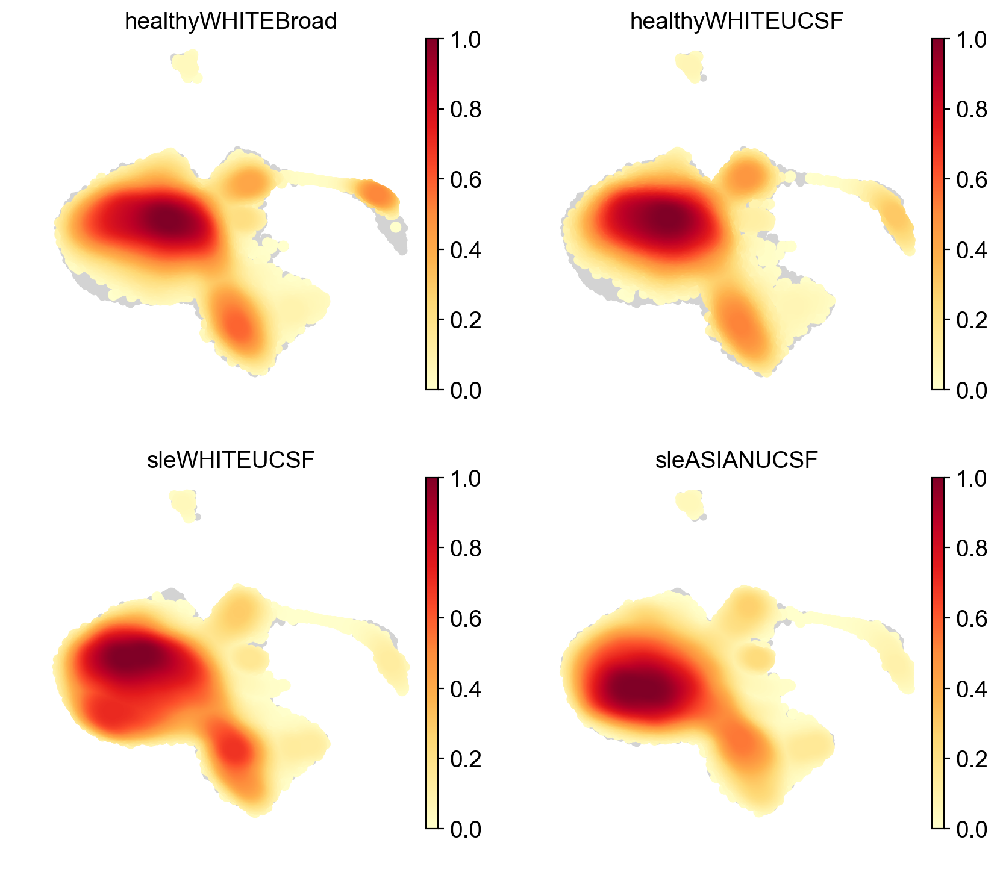

In [6]:
disease_umap = sc.pl.embedding_density(adata, basis="umap", key="umap_density_disease_pop_site_cov", frameon=False, ncols=2)
disease_umap = sc.pl.embedding_density(adata, basis="umap", key="umap_density_disease_pop_site_cov", frameon=False, ncols=2, save=".density.png")

In [7]:
# adata.uns['disease_pop_site_cov_colors'] = sc.pl.palettes.vega_20_scanpy;
# sc.pl.umap(adata, color='disease_pop_site_cov', size=3, edgecolor="none")

In [8]:
# sc.pl.umap(adata[adata.obs.disease_pop_site_cov=="healthyWHITEBroad"], color='disease_pop_site_cov', size=3, edgecolor="none")
# sc.pl.umap(adata[adata.obs.disease_pop_site_cov=="healthyWHITEUCSF"], color='disease_pop_site_cov', size=3, edgecolor="none")
# sc.pl.umap(adata[adata.obs.disease_pop_site_cov=="sleWHITEUCSF"], color='disease_pop_site_cov', size=3, edgecolor="none")
# sc.pl.umap(adata[adata.obs.disease_pop_site_cov=="sleASIANUCSF"], color='disease_pop_site_cov', size=3, edgecolor="none")


saving figure to file ./figures.V6/umap.ct_markers.png


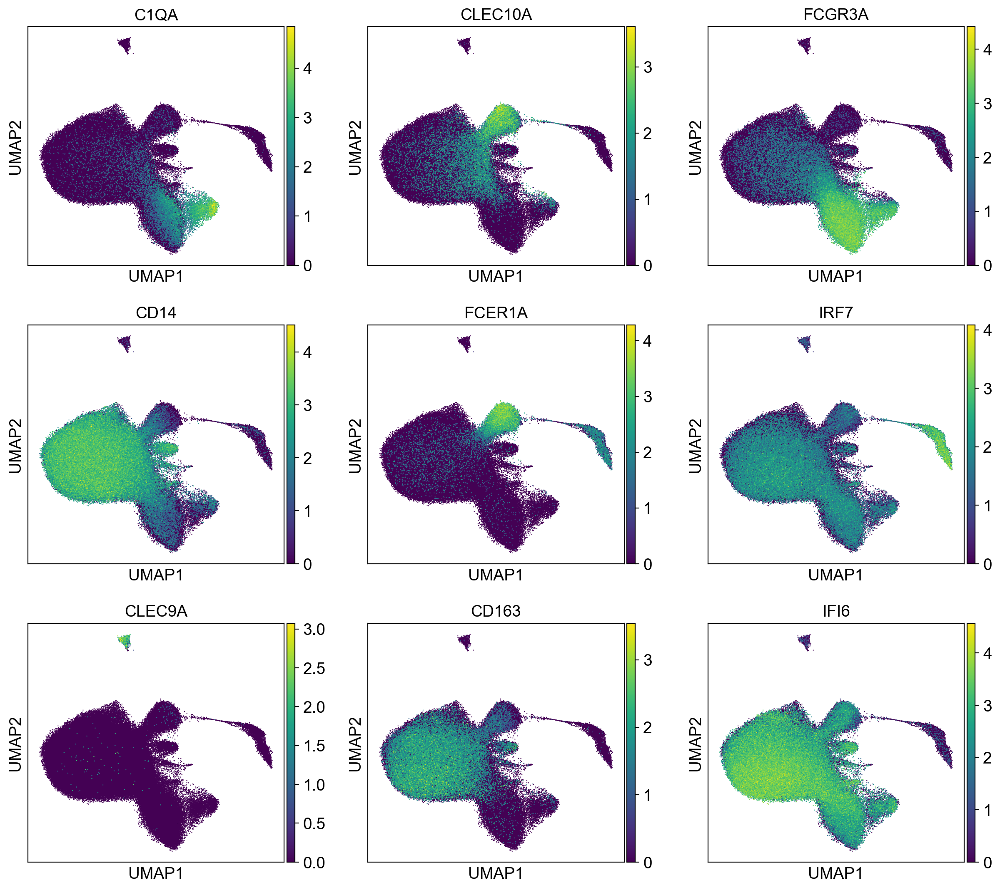

In [9]:
sc.pl.umap(adata, color=['C1QA','CLEC10A','FCGR3A', 'CD14', 'FCER1A', 'IRF7', 'CLEC9A', 'CD163', 'IFI6'], size=3, ncols=3)
sc.pl.umap(adata, color=['C1QA','CLEC10A','FCGR3A', 'CD14', 'FCER1A', 'IRF7', 'CLEC9A', 'CD163', 'IFI6'], size=3, ncols=3, save=".ct_markers.png")

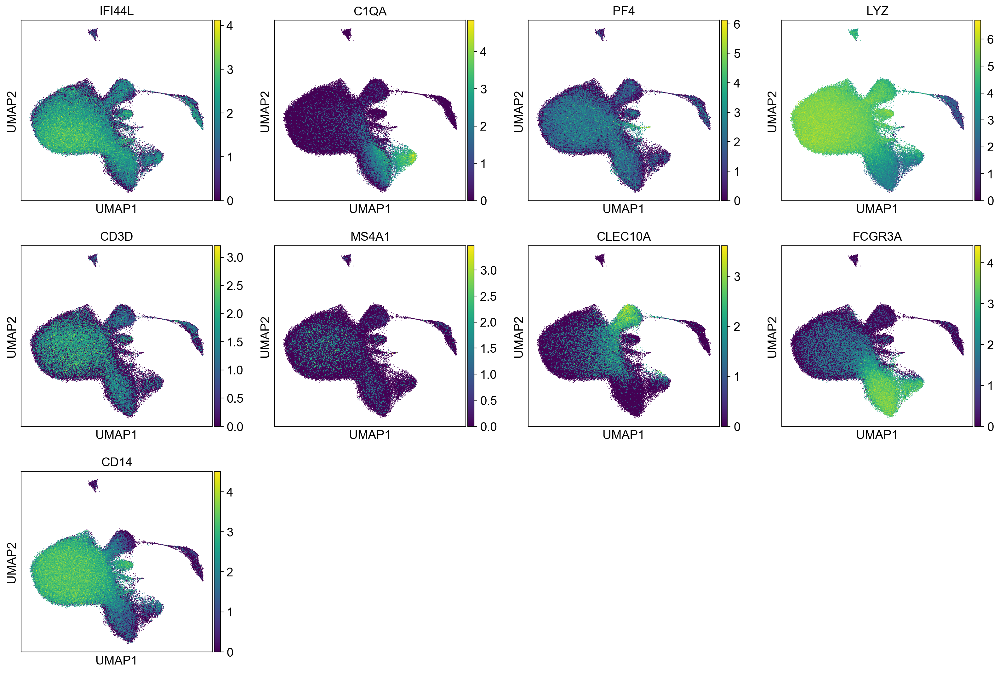

In [10]:
sc.pl.umap(adata, color=['IFI44L','C1QA','PF4','LYZ','CD3D','MS4A1', 'CLEC10A', 'FCGR3A', 'CD14'], size=3)

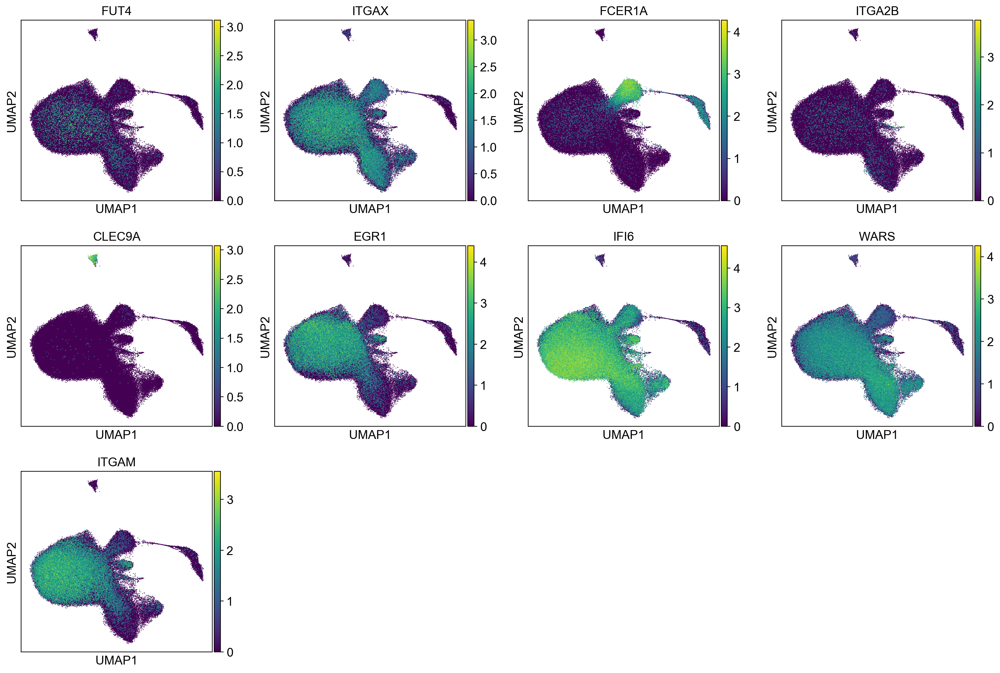

In [11]:
sc.pl.umap(adata, color=['FUT4', 'ITGAX', 'FCER1A', 'ITGA2B', 'CLEC9A', 'EGR1', 'IFI6', 'WARS', 'ITGAM'], size=3)

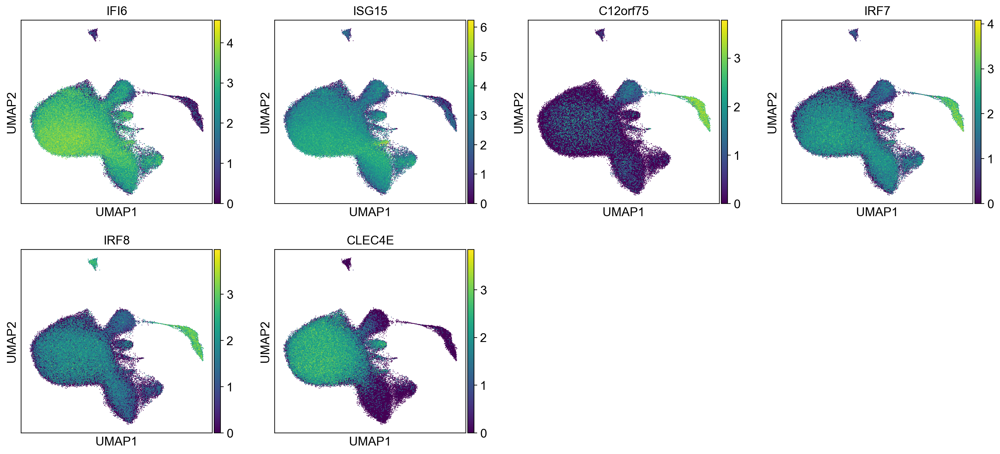

In [12]:
sc.pl.umap(adata, color=['IFI6', 'ISG15', 'C12orf75', 'IRF7', 'IRF8', 'CLEC4E'], size=3)

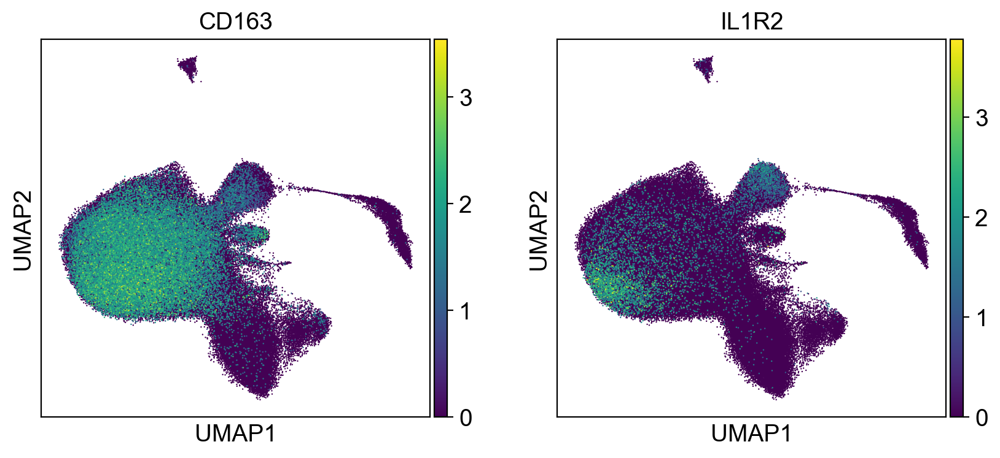

In [13]:
sc.pl.umap(adata, color=['CD163', 'IL1R2'], size=3)

In [14]:
# adata.obs.disease_cov.cat.reorder_categories(["healthy","sle"],inplace=True)
# sc.pl.umap(adata, color='disease_cov', size=3,  palette=['#B3B3B3','#000000'])
# sc.pl.umap(adata, color='disease_cov', size=3,  palette=['#B3B3B3','#000000'], save=".disease.png")

# look at IFN and cell lineage perc

/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:5: FutureWarning: read_table is deprecated, use read_csv instead.
  """


as a proportion of cell type
Cluster type:cM
Beta=1.1383875765546325, pvalue=5.376090239541265e-11
Cluster type:ncM
Beta=0.12208295801232298, pvalue=0.006639061892445878
Cluster type:cDC
Beta=-0.036073137219838805, pvalue=0.00031677334362258656
Cluster type:pDC
Beta=-0.016084393889764403, pvalue=0.00013902243957568766
Cluster type:Th
Beta=-1.132130918773631, pvalue=1.280048983590444e-12
Cluster type:Tc
Beta=-0.06999998948060829, pvalue=0.6211579033139798
Cluster type:Th
Beta=-1.132130918773631, pvalue=1.280048983590444e-12
Cluster type:NK
Beta=-0.1525658109740386, pvalue=0.0275388229715723
Cluster type:ProlifT
Beta=0.05591086250677517, pvalue=1.6300459175101188e-10
Cluster type:B
Beta=0.14166974033672952, pvalue=0.2895940288724021
Cluster type:MK
Beta=0.00493979007073711, pvalue=0.10011540584316832
Cluster type:Progen
Beta=-0.0014919311510247773, pvalue=0.15461413320580916
as a proportion of cell group
Cluster type:lymph
Beta=-1.1571161163847732, pvalue=1.7641155651508e-09
Cluster type

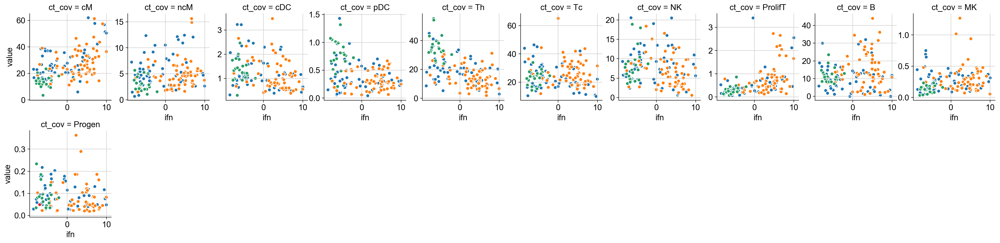

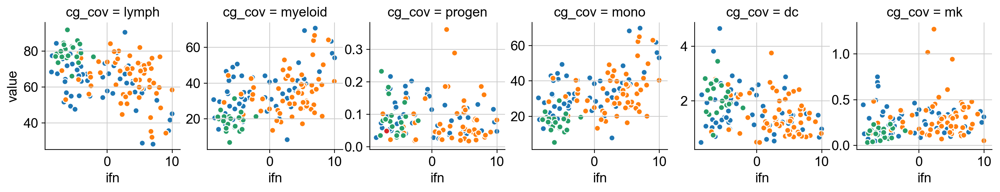

In [32]:
joined_pivot = pd.read_csv("CLUESImmVar_processed."+version+'_joined_pivot_ct_perc.txt',index_col=False)
joined_pivot_cg = pd.read_csv("CLUESImmVar_processed."+version+'_joined_pivot_cg_perc.txt',index_col=False)
joined_pivot_cg["myeloid"] = joined_pivot_cg.mono+joined_pivot_cg.dc

ifn = pd.read_table("v2.ifn.sig.txt", sep=" ", index_col=False)
ifn.name = ifn.name.apply(lambda x: x.split('_')[0])
joined_pivot_ifn = ifn.join(joined_pivot.set_index("ind_cov"), on="name")
joined_pivot_cg_ifn = ifn.join(joined_pivot_cg.set_index("ind_cov"), on="name")

cell_types = ["cM", "ncM", "cDC", "pDC", "Th","Tc","Th","NK","ProlifT","B","MK","Progen"];
cg_types = ['lymph', 'myeloid', 'progen', 'mono', 'dc','mk']

index = ["name","ifn","disease_cov","disease_pop_site_cov","batch_cov"];
joined_ifn = pd.melt(joined_pivot_ifn, id_vars=index, value_vars=cell_types, var_name="ct_cov")
joined_cg_ifn = pd.melt(joined_pivot_cg_ifn, id_vars=index, value_vars=cg_types, var_name="cg_cov")

##n_cts=ct_df.shape[1]-1
print('as a proportion of cell type')
for ct in cell_types :
    ##ct = ct_percs.leiden.cat.categories[ct_i]
    ct_perc = joined_pivot_ifn[ct]
    ifn = joined_pivot_ifn.ifn
    ifn = sm.add_constant(ifn)
    print('Cluster type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), ifn.astype(float),missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    print('Beta='+str(effect)+', pvalue='+str(pval))
    
g = sb.FacetGrid(joined_ifn, col="ct_cov",  hue="disease_pop_site_cov", aspect=0.8, height=3, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy, col_wrap=10)
g = g.map(plt.scatter, "ifn", "value", edgecolor="w")
g.fig.subplots_adjust(wspace=0.2)
g.savefig(figdir+"/ifn.ct_cov.png")

##n_cts=ct_df.shape[1]-1
print('as a proportion of cell group')
for cg in cg_types :
    ##ct = ct_percs.leiden.cat.categories[ct_i]
    cg_perc = joined_pivot_cg_ifn[cg]
    ifn = joined_pivot_cg_ifn.ifn
    ifn = sm.add_constant(ifn)
    print('Cluster type:'+ cg)
    est=sm.OLS(cg_perc.astype(float), ifn.astype(float),missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    print('Beta='+str(effect)+', pvalue='+str(pval))
    
g = sb.FacetGrid(joined_cg_ifn, col="cg_cov",  hue="disease_pop_site_cov", aspect=0.8, height=3, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy, col_wrap=10)
g = g.map(plt.scatter, "ifn", "value", edgecolor="w")

g.fig.subplots_adjust(wspace=0.2)
g.savefig(figdir+"/ifn.cg_cov.png",height=2)

# Now let's plot differences in cluster proportion for ALL samples including UCSF and Broad ImmVar

## Plotting Louvain

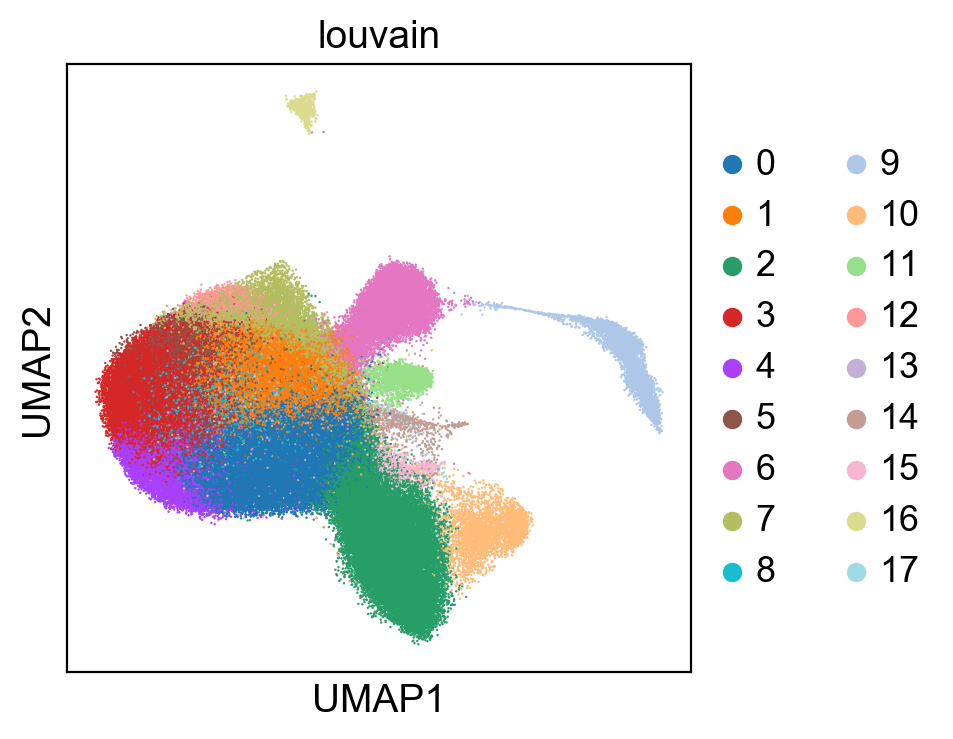

In [33]:
sc.pl.umap(adata, color='louvain', size=3, edgecolor="none")

ranking genes


/Users/yimmieg/anaconda3/lib/python3.6/site-packages/scanpy/tools/_rank_genes_groups.py:222: RuntimeWarning: invalid value encountered in log2
  rankings_gene_logfoldchanges.append(np.log2(foldchanges[global_indices]))


    finished (0:00:41.66)


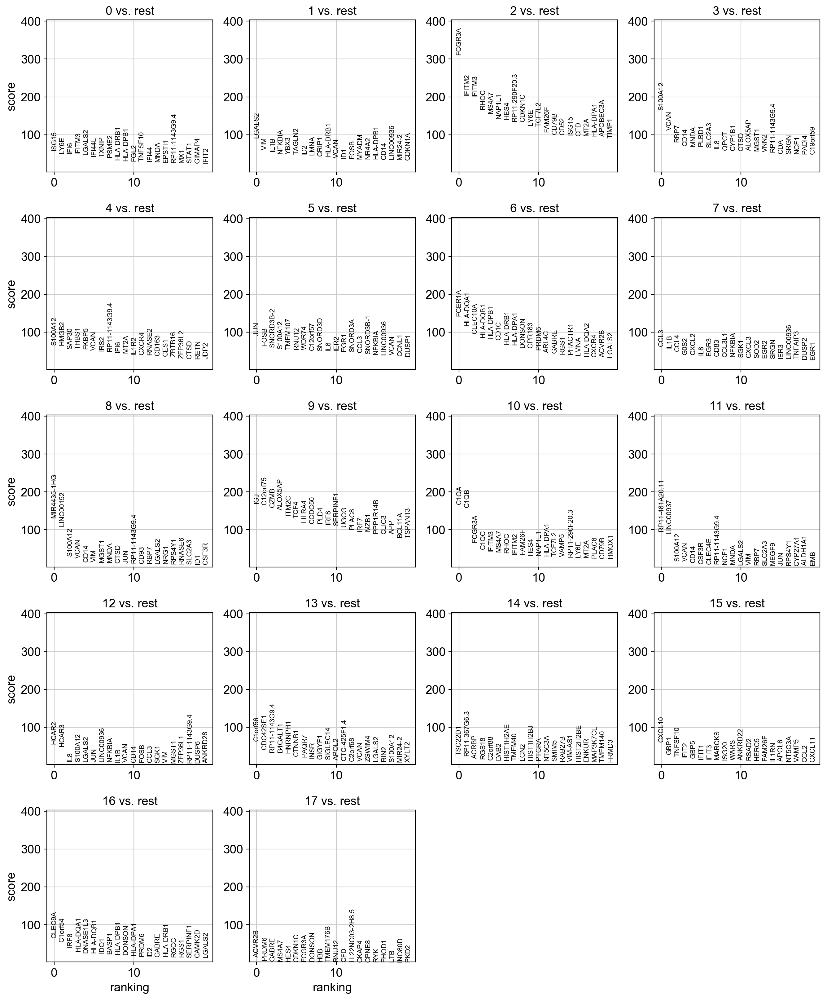

In [34]:
sc.tl.rank_genes_groups(adata, n_genes=20, groupby='louvain', use_raw=False)
sc.pl.rank_genes_groups(adata)

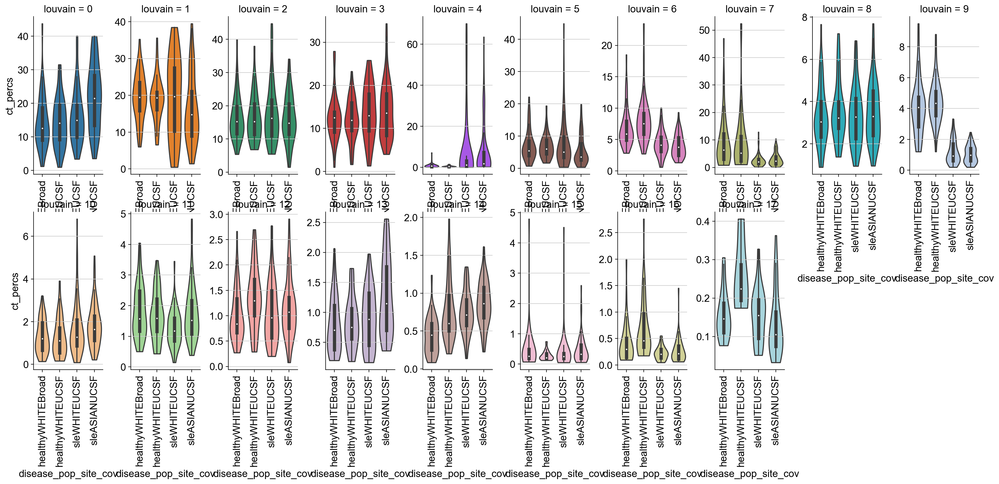

In [35]:
# ct_counts=adata.obs.groupby(['ind_cov', 'pop_cov', 'disease_cov', 'batch_cov', 'disease_pop_cov','louvain'])['louvain'].count()

# ##ind_count = ind_count.reset_index(name="counts")
# ct_counts_sums = ct_counts.groupby(["ind_cov","batch_cov"]).sum()
# ct_counts_sums = ct_counts_sums.reset_index(name="counts")

# ct_percs = ct_counts/ct_counts.groupby(["ind_cov","batch_cov"]).transform(sum)*100
# ct_percs = ct_percs.reset_index(name='ct_percs')

# ct_percs.ind_cov = ct_percs.ind_cov.apply(lambda x: x.split('_')[0])
# ct_percs.ind_cov = ct_percs.ind_cov.astype("str")
# ct_percs.reset_index(inplace=True)
# ct_percs.louvain = ct_percs.louvain.astype("category")
# ct_df=ct_percs.unstack(level=2, fill_value=0)

# ct_percs['site'] = pd.Categorical(ct_percs.disease_cov, categories=['Broad','UCSF'])
# ct_percs.site[ct_percs.batch_cov.str.contains("immvar")] = "Broad"
# ct_percs.site[~ct_percs.batch_cov.str.contains("immvar")] = "UCSF"

# ct_percs['disease_pop_site_cov'] = pd.Categorical(ct_percs.apply(lambda row: row['disease_cov'] + row['pop_cov'] + row['site'], axis=1),
#                                              categories=['healthyWHITEBroad','healthyWHITEUCSF','sleWHITEUCSF','sleASIANUCSF'],
#                                              ordered=True)


# ##plt.figure(figsize=(20,8))
# plot=sb.catplot(x='disease_pop_site_cov', y='ct_percs', hue='louvain', data=ct_percs, kind='violin', col='louvain', dodge=False, aspect=0.5, height=4, sharex=False, sharey=False, palette=adata.uns['leiden_colors'], cut=0, col_wrap=10) #, palette=sc.pl.palettes.vega_20_scanpy
# plot.set_xticklabels(rotation=90)
# plot.fig.subplots_adjust(wspace=0.4)

## Plotting Leiden

In [36]:
# sc.pl.umap(adata, color='leiden', size=3, edgecolor="none")

In [37]:
# sc.tl.rank_genes_groups(adata, n_genes=20, groupby='leiden', use_raw=False)
# sc.pl.rank_genes_groups(adata)

In [38]:
# ct_counts=adata.obs.groupby(['ind_cov', 'pop_cov', 'disease_cov', 'batch_cov', 'disease_pop_cov','leiden'])['leiden'].count()

# ##ind_count = ind_count.reset_index(name="counts")
# ct_counts_sums = ct_counts.groupby(["ind_cov","batch_cov"]).sum()
# ct_counts_sums = ct_counts_sums.reset_index(name="counts")

# ct_percs = ct_counts/ct_counts.groupby(["ind_cov","batch_cov"]).transform(sum)*100
# ct_percs = ct_percs.reset_index(name='ct_percs')

# ct_percs.ind_cov = ct_percs.ind_cov.apply(lambda x: x.split('_')[0])
# ct_percs.ind_cov = ct_percs.ind_cov.astype("str")
# ct_percs.reset_index(inplace=True)
# ct_percs.leiden = ct_percs.leiden.astype("category")
# ct_df=ct_percs.unstack(level=2, fill_value=0)

# ct_percs['site'] = pd.Categorical(ct_percs.disease_cov, categories=['Broad','UCSF'])
# ct_percs.site[ct_percs.batch_cov.str.contains("immvar")] = "Broad"
# ct_percs.site[~ct_percs.batch_cov.str.contains("immvar")] = "UCSF"

# ct_percs['disease_pop_site_cov'] = pd.Categorical(ct_percs.apply(lambda row: row['disease_cov'] + row['pop_cov'] + row['site'], axis=1),
#                                              categories=['healthyWHITEBroad','healthyWHITEUCSF','sleWHITEUCSF','sleASIANUCSF'],
#                                              ordered=True)


# ##plt.figure(figsize=(20,8))
# plot=sb.catplot(x='disease_pop_site_cov', y='ct_percs', hue='leiden', data=ct_percs, kind='violin', col='leiden', dodge=False, aspect=0.5, height=4, sharex=False, sharey=False, palette=adata.uns['leiden_colors'], cut=0, col_wrap=10) #, palette=sc.pl.palettes.vega_20_scanpy
# plot.set_xticklabels(rotation=90)
# plot.fig.subplots_adjust(wspace=0.4)

# # for ct_i in list(range(len(ct_percs.leiden.cat.categories))) :
# #     ct = ct_percs.leiden.cat.categories[ct_i]
# #     sb.swarmplot(x="disease_pop_site_cov", y="ct_percs", data=ct_percs[ct_percs.leiden == ct], color="0", size=3, ax=plot.axes[0,ct_i])
# #     plot.axes[0,ct_i].get_yaxis().label.set_visible(False)

# #plot.savefig(figdir+"/violin.cd4_pop.png")
# #plt.subplots_adjust(wspace=0.03)

### Let's look at the IFN score now

In [39]:
# ## Let's grab the clinical and labs data and compare to our single cell estimates
# clues_clinical = pd.read_table("v2.clinical.data.txt", index_col=False)
# clues_clinical.genotypeid = clues_clinical.genotypeid.apply(lambda x: x.split('_')[0])
# clues_clinical.subjectid = clues_clinical.subjectid.astype("str")
# joined = ct_percs.join(clues_clinical.set_index('genotypeid'), on='ind_cov')

# t1_labs = pd.read_table("T1labs.csv",sep=",")
# t1_labs.SubjectID = t1_labs.SubjectID.astype("str")
# joined = joined.join(t1_labs.set_index('SubjectID'), on='subjectid')

# ### test new code
# joined.AbsBaso = joined.AbsBaso/1000
# joined.AbsEosino = joined.AbsEosino/1000
# joined.AbsLympho = joined.AbsLympho/1000
# joined.AbsNeutro = joined.AbsNeutro/1000
# joined.AbsMono = joined.AbsMono/1000

# joined = joined.assign(pbmc = joined.WhiteBloodCell-joined.AbsNeutro-joined.AbsEosino-joined.AbsBaso)

# joined[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']] = joined[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']].astype(str)

# ## now let's add in white blood cell counts for the immvar patients
# immvar_pbmc = pd.read_table("immvar.pbmc.csv", index_col=False, sep=",")
# immvar_pbmc.pbmc = immvar_pbmc.pbmc - (np.mean(immvar_pbmc.pbmc) - np.mean(joined.pbmc))

# ## this is not the most efficient code but will suffice for now
# for i in list(range(12)) :
#     igtb = immvar_pbmc.immvarid[i]
#     joined.pbmc[joined.ind_cov==igtb] = immvar_pbmc.pbmc[i]

# joined = joined.assign(estimate=joined.ct_percs/100*joined.pbmc)

# joined[["ind_cov","disease_cov","leiden"]] = joined[["ind_cov","disease_cov","leiden"]].astype(str)
# joined.plaquenilnow = joined.plaquenilnow.fillna(0)
# joined.cellceptnow = joined.cellceptnow.fillna(0)
# joined.steroralnow = joined.steroralnow.fillna(0)
# joined.acrlymphopenia = joined.acrlymphopenia.fillna(0)

# joined_pivot = joined.pivot_table(index=['ind_cov',"disease_cov","pbmc","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="leiden", values="estimate")
# joined_pivot.reset_index(inplace=True)
# joined_pivot = joined_pivot[joined_pivot.pbmc > 0]
# joined_pivot.disease_cov = pd.Categorical(joined_pivot.disease_cov,categories=['healthy','sle'], ordered=True)

# ifn = pd.read_table("v2.ifn.sig.txt", sep=" ", index_col=False)
# ifn.name = ifn.name.apply(lambda x: x.split('_')[0])
# joined2 = ifn.join(joined.set_index("ind_cov"), on="name")




# joined_pivot2 = joined2.pivot_table(index=['name',"disease_cov","pbmc","ifn","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="leiden", values="estimate")
# joined_pivot2.reset_index(inplace=True)

# print(joined_pivot2[joined_pivot2.pbmc < 0])
# joined_pivot2 = joined_pivot2[joined_pivot2.pbmc > 0]

# print(joined_pivot2[joined_pivot2.pbmc > 10])
# joined_pivot2 = joined_pivot2[joined_pivot2.pbmc < 10]

# ##n_cts=ct_df.shape[1]-1
# print('as a proportion of cell type')
# for ct_i in list(range(0,len(adata.obs.leiden.cat.categories))):
#     ct = ct_percs.leiden.cat.categories[ct_i]
#     ct_perc = joined_pivot2[ct]
#     ifn = joined_pivot2.ifn
#     ifn = sm.add_constant(ifn)
#     print('Cluster type:'+ ct)
#     est=sm.OLS(ct_perc.astype(float), ifn.astype(float),missing='drop')
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     print('Beta='+str(effect)+', pvalue='+str(pval))

# joined_pivot2_percs = joined2.pivot_table(index=['name',"disease_cov","pbmc","ifn","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="leiden", values="ct_percs")
# joined_pivot2_percs.reset_index(inplace=True)

# print(joined_pivot2_percs[joined_pivot2_percs.pbmc < 0])
# joined_pivot2_percs = joined_pivot2_percs[joined_pivot2_percs.pbmc > 0]

# print(joined_pivot2_percs[joined_pivot2_percs.pbmc > 10])
# joined_pivot2_percs = joined_pivot2_percs[joined_pivot2_percs.pbmc < 10]

# ##n_cts=ct_df.shape[1]-1
# print('as a proportion of cell type')
# for ct_i in list(range(0,len(adata.obs.leiden.cat.categories))):
#     ct = ct_percs.leiden.cat.categories[ct_i]
#     ct_perc = joined_pivot2_percs[ct]
#     ifn = joined_pivot2_percs.ifn
#     ifn = sm.add_constant(ifn)
#     print('Cluster type:'+ ct)
#     est=sm.OLS(ct_perc.astype(float), ifn.astype(float),missing='drop')
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     print('Beta='+str(effect)+', pvalue='+str(pval))

# # fig,ax = plt.subplots(nrows=1,ncols=len(adata.obs.leiden.cat.categories), figsize=(20,4))
# # fig.tight_layout()

    
# # for ct_i in list(range(0,len(adata.obs.leiden.cat.categories))):
# #     ct = ct_percs.leiden.cat.categories[ct_i]
# #     sb.scatterplot(x="ifn", y=ct, data=joined_pivot2_percs, color=sc.pl.palettes.vega_20_scanpy[ct_i], ax=ax[ct_i])
# #     ax[ct_i].get_yaxis().label.set_visible(False)
# #     ##sb.swarmplot(x="disease_cov", y=ct, data=joined_pivot, color="0", size=3, ax=ax[ct_i])

    
# # fig.savefig(figdir+"/ifn.ct_cov.png")



In [40]:
# joined2.leiden = pd.Categorical(joined2.leiden,
#                                 categories=['0', '1', '2', '3', '4', '5', '7', '8', '9', '10', '11', '12','15','16','17'],
#                                 ordered=True)
# g = sb.FacetGrid(joined2, col="leiden",  hue="disease_cov", aspect=0.8, height=3, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy, col_wrap=10)
# g = g.map(plt.scatter, "ifn", "ct_percs", edgecolor="w")
# g.fig.subplots_adjust(wspace=0.2)

# look at cell types

In [41]:
# adata.obs['ct_cov'] = adata.obs['ct_cov'].astype('object')

# ## do some manual cell type assignment
# adata.obs.loc[adata.obs.leiden == "0","ct_cov"] = "cM" # CCR7, SOCS3-, TNF- CREM-
# adata.obs.loc[adata.obs.leiden == "1","ct_cov"] = "ncM"# CCR7-, GATA3, RORA, CD45+, IL7R, CREM+
# adata.obs.loc[adata.obs.leiden == "2","ct_cov"] = "Mact" # PRF1, CD8+, IL7R-
# adata.obs.loc[adata.obs.leiden == "3","ct_cov"] = "cM" ## is memory above # CD69+, CCR7+, SOCS3+ CREM+
# adata.obs.loc[adata.obs.leiden == "4","ct_cov"] = "cMact" # CCR7+, CD8+
# adata.obs.loc[adata.obs.leiden == "5","ct_cov"] = "cM"# CREM+ CD8+, IL7R+
# adata.obs.loc[adata.obs.leiden == "6","ct_cov"] = "cDC1" # CCR7+, FOXP1+
# adata.obs.loc[adata.obs.leiden == "7","ct_cov"] = "infM"# PRF1+, CD8-, IL7+, CREM-, 
# adata.obs.loc[adata.obs.leiden == "8","ct_cov"] = "iM" # CCR7+ CD8-, S100A4- 
# adata.obs.loc[adata.obs.leiden == "9","ct_cov"] = "pDC" # IL2RA+, CTLA4+, FOXP3+
# adata.obs.loc[adata.obs.leiden == "10","ct_cov"] = "compM" # IFN+, STAT1+
# adata.obs.loc[adata.obs.leiden == "11","ct_cov"] = "Mac1" # clec4e
# adata.obs.loc[adata.obs.leiden == "12","ct_cov"] = "infM" # STMN1+ SOX4+
# adata.obs.loc[adata.obs.leiden == "13","ct_cov"] = "iM" # PTCRA+
# adata.obs.loc[adata.obs.leiden == "14","ct_cov"] = "not sure" # MNDA, CD14, FCER1G
# adata.obs.loc[adata.obs.leiden == "15","ct_cov"] = "Mac2" # STMN1+ SOX4+
# adata.obs.loc[adata.obs.leiden == "16","ct_cov"] = "cDC2" # PTCRA+
# adata.obs.loc[adata.obs.leiden == "17","ct_cov"] = "ncMact" # MNDA, CD14, FCER1G

# adata.obs['ct_cov'] = adata.obs['ct_cov'].astype('category')

In [42]:
adata.obs['ct_cov'] = adata.obs['ct_cov'].astype('object')

## do some manual cell type assignment
adata.obs.loc[adata.obs.louvain == "0","ct_cov"] = "cMact" # CCR7, SOCS3-, TNF- CREM-
adata.obs.loc[adata.obs.louvain == "1","ct_cov"] = "cMinf"# CCR7-, GATA3, RORA, CD45+, IL7R, CREM+
adata.obs.loc[adata.obs.louvain == "2","ct_cov"] = "ncM" # PRF1, CD8+, IL7R-
adata.obs.loc[adata.obs.louvain == "3","ct_cov"] = "cM" ## is memory above # CD69+, CCR7+, SOCS3+ CREM+
adata.obs.loc[adata.obs.louvain == "4","ct_cov"] = "cMact" # CCR7+, CD8+
adata.obs.loc[adata.obs.louvain == "5","ct_cov"] = "cM"# CREM+ CD8+, IL7R+
adata.obs.loc[adata.obs.louvain == "6","ct_cov"] = "cDC1" # CCR7+, FOXP1+
adata.obs.loc[adata.obs.louvain == "7","ct_cov"] = "cMinf"# PRF1+, CD8-, IL7+, CREM-, 
adata.obs.loc[adata.obs.louvain == "8","ct_cov"] = "cM" # CCR7+ CD8-, S100A4- 
adata.obs.loc[adata.obs.louvain == "9","ct_cov"] = "pDC" # IL2RA+, CTLA4+, FOXP3+
adata.obs.loc[adata.obs.louvain == "10","ct_cov"] = "ncMcomp" # IFN+, STAT1+
adata.obs.loc[adata.obs.louvain == "11","ct_cov"] = "Mac1" # clec4e
adata.obs.loc[adata.obs.louvain == "12","ct_cov"] = "cM" # STMN1+ SOX4+
adata.obs.loc[adata.obs.louvain == "13","ct_cov"] = "cMinf" # PTCRA+
adata.obs.loc[adata.obs.louvain == "14","ct_cov"] = "Mac2" # MNDA, CD14, FCER1G
adata.obs.loc[adata.obs.louvain == "15","ct_cov"] = "Mac2" # STMN1+ SOX4+
adata.obs.loc[adata.obs.louvain == "16","ct_cov"] = "cDC2" # PTCRA+
adata.obs.loc[adata.obs.louvain == "17","ct_cov"] = "Mac2" # MNDA, CD14, FCER1G

adata.obs['ct_cov'] = adata.obs['ct_cov'].astype('category')

adata.obs.ct_cov = adata.obs.ct_cov.cat.reorder_categories(['cM', 'cMact', 'cMinf', 'Mac1', 'Mac2', 'ncM', 'ncMcomp', 'cDC1', 'cDC2', 'pDC'])

saving figure to file ./figures.V6/umap.ct_cov.all.png


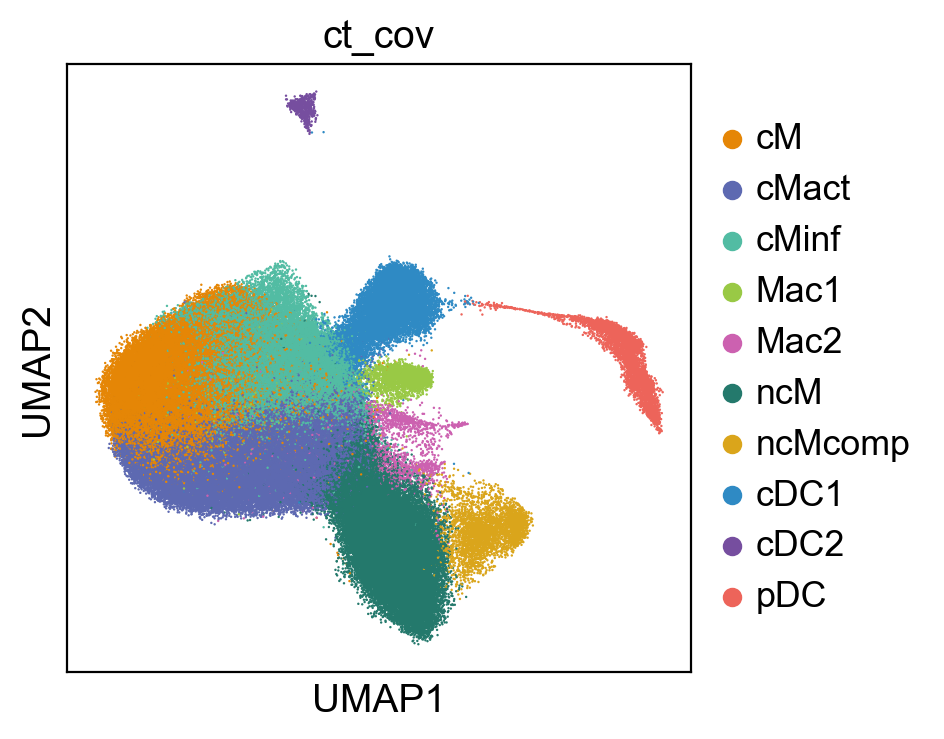

In [43]:
adata.uns['ct_cov_colors'] = ["#E58606","#5D69B1","#52BCA3","#99C945","#CC61B0","#24796C","#DAA51B","#2F8AC4","#764E9F","#ED645A","#CC3A8E","#A5AA99"]

sc.pl.umap(adata, color='ct_cov', size=3, edgecolor="none")
sc.pl.umap(adata, color='ct_cov', size=3, save=".ct_cov.all.png")

In [44]:
def marker_gene_expression(anndata, marker_dict, gene_symbol_key=None, partition_key='louvain_r1'):
    """A function go get mean z-score expressions of marker genes
    # 
    # Inputs:
    #    anndata         - An AnnData object containing the data set and a partition
    #    marker_dict     - A dictionary with cell-type markers. The markers should be stores as anndata.var_names or 
    #                      an anndata.var field with the key given by the gene_symbol_key input
    #    gene_symbol_key - The key for the anndata.var field with gene IDs or names that correspond to the marker 
    #                      genes
    #    partition_key   - The key for the anndata.obs field where the cluster IDs are stored. The default is
    #                      'louvain_r1' """

    #Test inputs
    if partition_key not in anndata.obs.columns.values:
        print('KeyError: The partition key was not found in the passed AnnData object.')
        print('   Have you done the clustering? If so, please tell pass the cluster IDs with the AnnData object!')
        raise

    if (gene_symbol_key != None) and (gene_symbol_key not in anndata.var.columns.values):
        print('KeyError: The provided gene symbol key was not found in the passed AnnData object.')
        print('   Check that your cell type markers are given in a format that your anndata object knows!')
        raise
        

    if gene_symbol_key:
        gene_ids = anndata.var[gene_symbol_key]
    else:
        gene_ids = anndata.var_names

    clusters = anndata.obs[partition_key].cat.categories
    n_clust = len(clusters)
    marker_exp = pd.DataFrame(columns=clusters)
    marker_exp['cell_type'] = pd.Series({}, dtype='str')
    marker_names = []
    
    z_scores = sc.pp.scale(anndata, copy=True)

    i = 0
    for group in marker_dict:
        # Find the corresponding columns and get their mean expression in the cluster
        for gene in marker_dict[group]:
            ens_idx = np.in1d(gene_ids, gene) #Note there may be multiple mappings
            if np.sum(ens_idx) == 0:
                continue
            else:
                z_scores.obs[ens_idx[0]] = z_scores.X[:,ens_idx].mean(1) #works for both single and multiple mapping
                ens_idx = ens_idx[0]

            clust_marker_exp = z_scores.obs.groupby(partition_key)[ens_idx].apply(np.mean).tolist()
            clust_marker_exp.append(group)
            marker_exp.loc[i] = clust_marker_exp
            marker_names.append(gene)
            i+=1

    #Replace the rownames with informative gene symbols
    marker_exp.index = marker_names

    return(marker_exp)

In [45]:
marker_dictionary = pd.DataFrame({"all": adata.var_names})

rst = marker_gene_expression(adata, marker_dictionary, partition_key="ct_cov")

rst.to_csv("myeloid_expr.ct_cov.csv")

ranking genes
    finished (0:00:26.63)


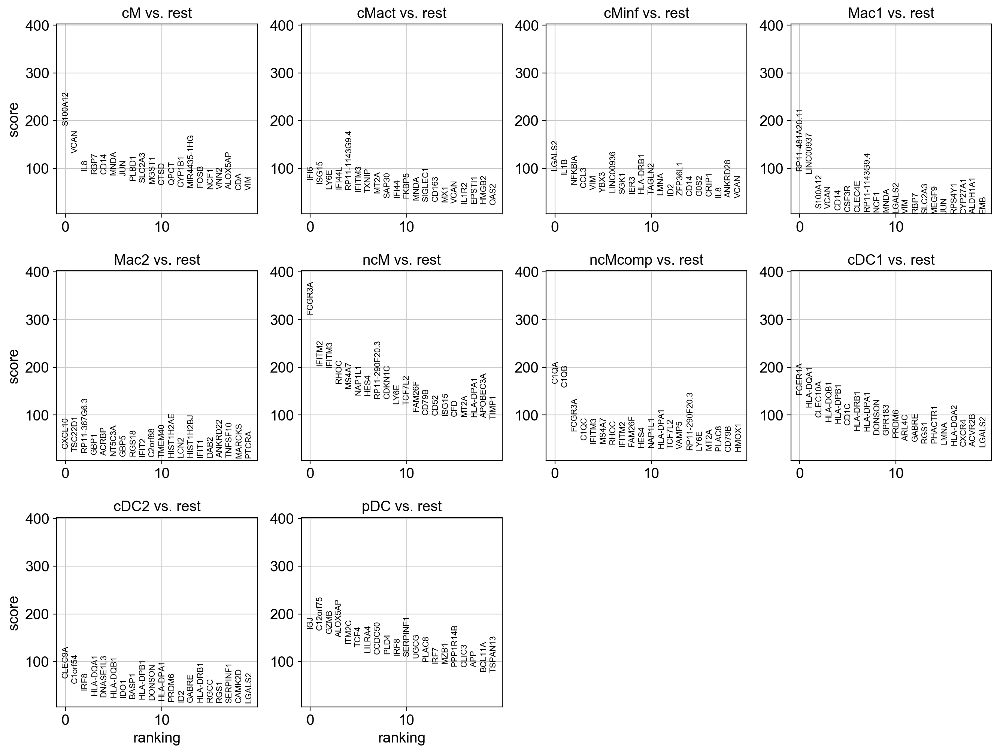

In [46]:
sc.tl.rank_genes_groups(adata, n_genes=20, groupby='ct_cov', use_raw=False)
sc.pl.rank_genes_groups(adata)

In [47]:
pd.set_option('display.max_columns', None)
unique_ct_cov = np.unique(adata.obs['ct_cov'].values)
# Compile list of top genes
GeneRanks = pd.DataFrame()
for ii in range(len(unique_ct_cov)):
    GeneRanks[unique_ct_cov[ii]] = adata.var_names[np.flipud(np.argsort(np.mean(adata.X[adata.obs['ct_cov'] == unique_ct_cov[ii]], axis=0)))]
##GeneRanks.to_csv('FLARE_top_expression.csv')
GeneRanks.head(20)

,Mac1,Mac2,cDC1,cDC2,cM,cMact,cMinf,ncM,ncMcomp,pDC
0,RP11-481A20.11,CXCL10,FCER1A,CLEC9A,S100A12,IFI6,LGALS2,FCGR3A,C1QB,LILRA4
1,LINC00937,RP11-367G6.3,CLEC10A,IDO1,VCAN,ISG15,IL1B,RHOC,C1QA,IGJ
2,S100A12,TSC22D1,CD1C,C1orf54,IL8,IFI44L,CCL3,CDKN1C,C1QC,ITM2C
3,VCAN,C2orf88,HLA-DQA1,DNASE1L3,RBP7,LY6E,NFKBIA,HES4,FCGR3A,SERPINF1
4,CD14,LCN2,HLA-DQB1,IRF8,CD14,RP11-1143G9.4,VIM,IFITM2,RHOC,GZMB
5,CSF3R,TMEM40,HLA-DPB1,BASP1,MNDA,IFITM3,LMNA,IFITM3,HES4,MZB1
6,CLEC4E,ACRBP,GPR183,S100B,JUN,MT2A,YBX3,MS4A7,MS4A7,TPM2
7,RP11-1143G9.4,HIST1H2BJ,LMNA,HLA-DQA1,PLBD1,SAP30,SGK1,TCF7L2,LYPD2,SCT
8,MNDA,HIST1H2AE,HLA-DPA1,SERPINF1,QPCT,TXNIP,LINC00936,RP11-290F20.3,TCF7L2,LRRC26
9,NCF1,RAB27B,HLA-DRB1,HLA-DQB1,SLC2A3,IFI44,IER3,NAP1L1,IFITM3,DERL3


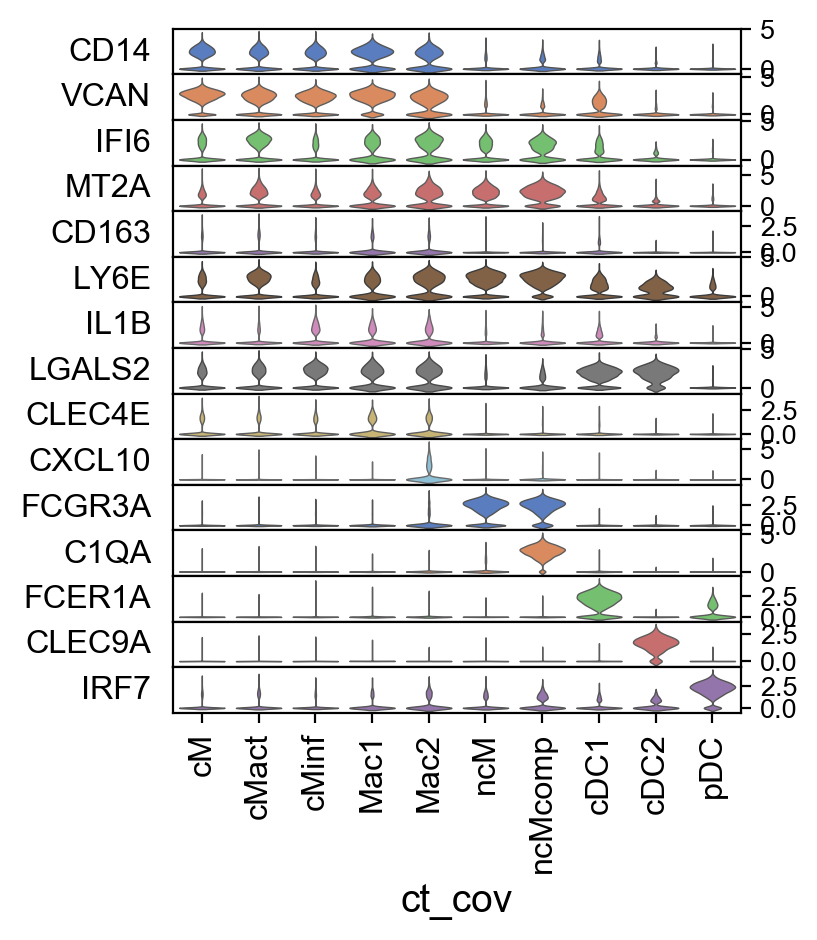

In [48]:
sc.pl.stacked_violin(adata, var_names=['CD14','VCAN','IFI6','MT2A','CD163','LY6E','IL1B','LGALS2','CLEC4E','CXCL10','FCGR3A','C1QA','FCER1A', 'CLEC9A','IRF7'], groupby="ct_cov", swap_axes= True)

saving figure to file ./figures.V6/stacked_violin.violin.png


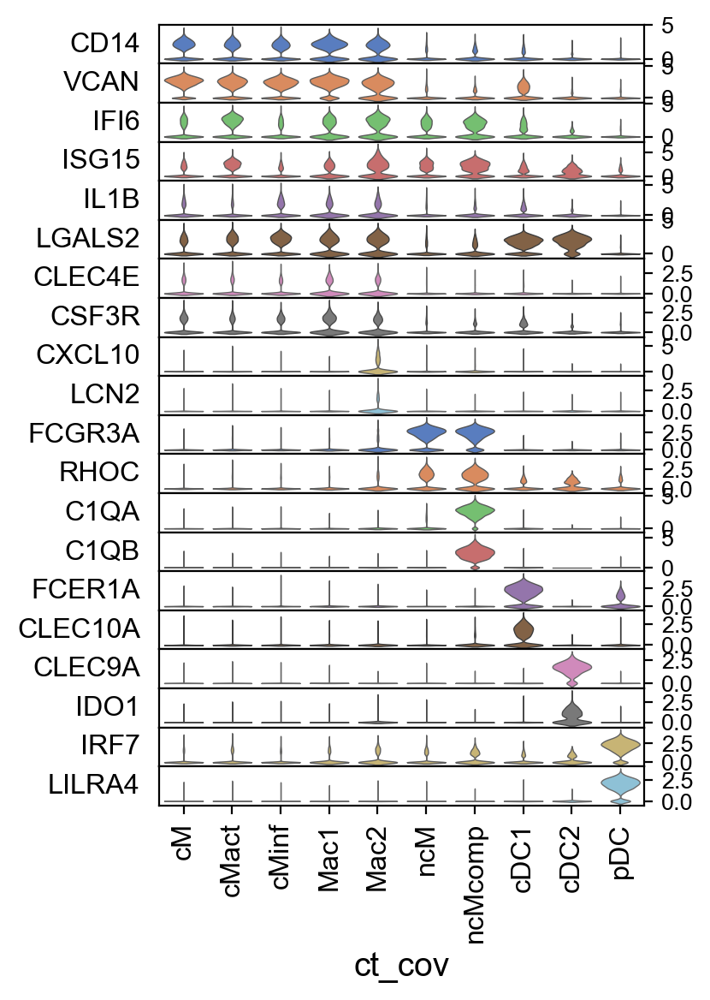

In [49]:
sc.pl.stacked_violin(adata, var_names=['CD14','VCAN','IFI6','ISG15','IL1B','LGALS2','CLEC4E','CSF3R','CXCL10','LCN2','FCGR3A','RHOC','C1QA','C1QB','FCER1A','CLEC10A', 'CLEC9A','IDO1','IRF7','LILRA4'], groupby="ct_cov", swap_axes= True)
sc.pl.stacked_violin(adata, var_names=['CD14','VCAN','IFI6','ISG15','IL1B','LGALS2','CLEC4E','CSF3R','CXCL10','LCN2','FCGR3A','RHOC','C1QA','C1QB','FCER1A','CLEC10A','CLEC9A','IDO1','IRF7','LILRA4'], groupby="ct_cov", save=".violin.png", swap_axes=True)

## calculating percentage effect using code from figure 1

In [50]:
## Make proportion plots (Fig. 1D)

##adata_obs_small = adata.obs[(adata.obs.study_cov=="ImmVar") & (adata.obs.ind_cov.str.contains("IGTB")) | (~adata.obs.ind_cov.str.contains("IGTB") & (adata.obs.study_cov=="CLUES"))]
##adata_obs_small = adata.obs[(adata.obs.well.str.contains("immvar")) & (adata.obs.ind_cov.str.contains("IGTB")) | (~adata.obs.ind_cov.str.contains("IGTB") & ~adata.obs.well.str.contains("immvar"))]
adata_obs_small = adata.obs;##[(adata.obs.batch_cov.str.contains("lupus"))]

##ind_count = adata_obs_small.groupby(['ind_cov','study_cov','ct_cov','disease_cov','pop_cov','batch_cov'])['ct_cov'].count()

## no batch_cov so that we aggregate the count for the two healthy controls
ind_count = adata_obs_small.groupby(['ind_cov','ct_cov','disease_cov','pop_cov','batch_cov','site'])['ct_cov'].count()

##ind_count = adata.obs.groupby(['ind_cov','study_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()
##ind_count = adata.obs.groupby(['ind_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()

##ind_count = ind_count.reset_index(name="counts")
ind_count_sums = ind_count.groupby(["ind_cov","batch_cov"]).sum()
ind_count_sums = ind_count_sums.reset_index(name="counts")

##ind_perc = ind_count/ind_count.groupby(["ind_cov","batch_cov"]).transform(sum)*100
ind_perc = ind_count/ind_count.groupby(["ind_cov","batch_cov"]).transform(sum)*100
ind_perc = ind_perc.reset_index(name="ct_perc")

## filter samples that have < 100 cells
ind_perc = ind_perc[ind_perc.ind_cov.isin(ind_count_sums.ind_cov[ind_count_sums.counts > 100])]


In [51]:
print(ind_perc.shape)
print(ind_count_sums.shape)

## for now, let's filter out one of the reps for the healthies from UCSF only
ind_perc_broad = ind_perc[~ind_perc.batch_cov.str.contains("lupus")]
ind_perc_ucsf = ind_perc[ind_perc.batch_cov.str.contains("lupus")].drop_duplicates(subset=['ct_cov','ind_cov'])
ind_perc = ind_perc_ucsf.append(ind_perc_broad);

ind_count_sums_broad = ind_count_sums[~ind_count_sums.batch_cov.str.contains("lupus")]
ind_count_sums_ucsf = ind_count_sums[ind_count_sums.batch_cov.str.contains("lupus")].drop_duplicates(subset=['ind_cov'])
ind_count_sums = ind_count_sums_ucsf.append(ind_count_sums_broad);

print(ind_perc.shape)
print(ind_count_sums.shape)

##ind_count = ind_count.drop_duplicates(subset=['ct_cov','ind_cov'])

(2017, 7)
(206, 3)
(1848, 7)
(188, 3)


In [52]:
ind_perc.ind_cov = ind_perc.ind_cov.apply(lambda x: x.split('_')[0])
ind_count_sums.ind_cov = ind_count_sums.ind_cov.apply(lambda x: x.split('_')[0])
ind_perc.ind_cov = ind_perc.ind_cov.astype("str")
ind_perc.batch_cov = ind_perc.batch_cov.astype("str")
ind_perc.reset_index(inplace=True)
ind_perc.ct_cov = ind_perc.ct_cov.astype('category')
ind_perc.ct_cov = ind_perc.ct_cov.cat.reorder_categories(adata.obs.ct_cov.cat.categories.values)
## do this to get monos and lympho to have similar colors as the major cell types


ind_perc['site'] = pd.Categorical(ind_perc.disease_cov, categories=['Broad','UCSF'])
ind_perc.site[ind_perc.batch_cov.str.contains("immvar")] = "Broad"
ind_perc.site[~ind_perc.batch_cov.str.contains("immvar")] = "UCSF"

ind_perc['disease_pop_site_cov'] = pd.Categorical(ind_perc.apply(lambda row: row['disease_cov'] + row['pop_cov'] + row['site'], axis=1),
                                             categories=['healthyWHITEBroad','healthyWHITEUCSF','sleWHITEUCSF','sleASIANUCSF'],
                                             ordered=True)

print('as a proportion of total PBMC ')

for ct_i in list(range(10)) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = ind_perc.ct_perc[ind_perc.ct_cov==ct]
    disease = ind_perc.disease_cov[ind_perc.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    est=sm.OLS(ct_perc.astype(float), disease.astype(float))
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    r2=est.rsquared
    print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval))
    
    
    
print('\nwhite sle vs white healthy')

for ct_i in list(range(10)) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = ind_perc[ind_perc.pop_cov=="WHITE"].ct_perc[ind_perc.ct_cov==ct]
    disease = ind_perc[ind_perc.pop_cov=="WHITE"].disease_cov[ind_perc.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    est=sm.OLS(ct_perc.astype(float), disease.astype(float))
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    r2=est.rsquared
    print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval))
    
    
print('\nasian sle vs white healthy')

for ct_i in list(range(10)) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = ind_perc[((ind_perc.pop_cov=="WHITE") & (ind_perc.disease_cov=="healthy")) | ((ind_perc.pop_cov=="ASIAN") & (ind_perc.disease_cov=="sle"))].ct_perc[ind_perc.ct_cov==ct]
    disease = ind_perc[((ind_perc.pop_cov=="WHITE") & (ind_perc.disease_cov=="healthy")) | ((ind_perc.pop_cov=="ASIAN") & (ind_perc.disease_cov=="sle"))].disease_cov[ind_perc.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    est=sm.OLS(ct_perc.astype(float), disease.astype(float))
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    r2=est.rsquared
    print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval))
    
    
print('\nwhite sle vs asian sle')

for ct_i in list(range(10)) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = ind_perc[ind_perc.disease_cov=="sle"].ct_perc[ind_perc.ct_cov==ct]
    pop = ind_perc[ind_perc.disease_cov=="sle"].pop_cov[ind_perc.ct_cov==ct]
    pop = pop.astype("str")
    pop.values[pop=="ASIAN"] = 0
    pop.values[pop=="WHITE"] = 1
    pop = sm.add_constant(pop)
    ##data = data.assign(ct_perc=ct_perc)
    est=sm.OLS(ct_perc.astype(float), pop.astype(float))
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    r2=est.rsquared
    print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval))

as a proportion of total PBMC 
Cluster=cM, Beta=-0.9820924522875518, R2=0.0031059847484610215, pvalue=0.44746729551950726
Cluster=cMact, Beta=-11.879151338022304, R2=0.14113964133931323, pvalue=1.0801765438713521e-07
Cluster=cMinf, Beta=7.77739989897956, R2=0.11001300129623481, pvalue=3.323026032428347e-06
Cluster=Mac1, Beta=0.2155057178535466, R2=0.015809600452531547, pvalue=0.08640025470340441
Cluster=Mac2, Beta=-0.38083090671340336, R2=0.08063325079349337, pvalue=8.574398197608222e-05
Cluster=ncM, Beta=-0.5491597040080243, R2=0.0012531694783757263, pvalue=0.6295955435977765
Cluster=ncMcomp, Beta=-0.4700921038452786, R2=0.046701532646862054, pvalue=0.002895650213024966
Cluster=cDC1, Beta=2.9922806059738924, R2=0.25819331023001946, pvalue=9.800841174240642e-14
Cluster=cDC2, Beta=0.24728545190573503, R2=0.14031659803580032, pvalue=1.0612610258636093e-06
Cluster=pDC, Beta=3.0749385071699886, R2=0.6378435628457947, pvalue=1.1534550183529508e-42

white sle vs white healthy
Cluster=cM, Bet

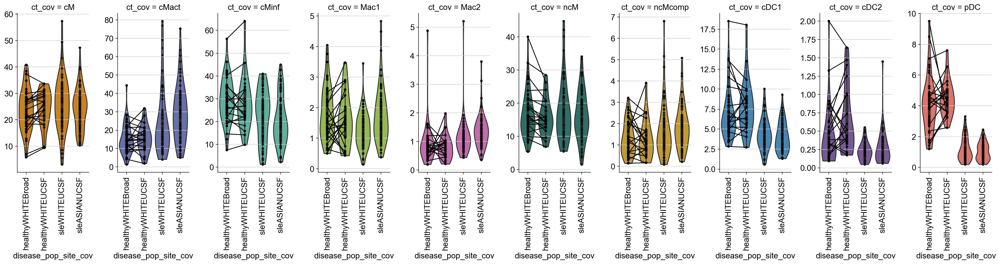

In [53]:
##plt.figure(figsize=(20,8))
plot=sb.catplot(x='disease_pop_site_cov', y='ct_perc', hue='ct_cov', data=ind_perc, kind='violin', col='ct_cov', 
                dodge=False, aspect=0.5, height=5, sharex=False, sharey=False, cut=0, col_wrap=10,
               palette = ["#E58606","#5D69B1","#52BCA3","#99C945","#CC61B0","#24796C","#DAA51B","#2F8AC4","#764E9F","#ED645A","#CC3A8E","#A5AA99"]) #, palette=sc.pl.palettes.vega_20_scanpy
plot.set_xticklabels(rotation=90)
plot.fig.subplots_adjust(wspace=0.4, hspace=0.75)

for ct_i in list(range(len(ind_perc.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    
    sb.pointplot(x="disease_pop_site_cov", y="ct_perc", hue = "ind_cov", data=ind_perc[ind_perc.ct_cov == ct], color="0", scale=0.5,
                 ax=plot.axes[ct_i], legend=False)
    
    plot.axes[ct_i].get_yaxis().label.set_visible(False)
    plot.axes[ct_i].get_legend().remove()
    
    plot.axes[ct_i].get_yaxis().label.set_visible(False)

plot.savefig(figdir+"/violin.myeloid.png")


In [54]:
# ct_counts=adata.obs.groupby(['ind_cov', 'pop_cov', 'disease_cov', 'batch_cov', 'disease_pop_cov','ct_cov'])['ct_cov'].count()

# ##ind_count = ind_count.reset_index(name="counts")
# ct_counts_sums = ct_counts.groupby(["ind_cov","batch_cov"]).sum()
# ct_counts_sums = ct_counts_sums.reset_index(name="counts")

# ct_percs = ct_counts/ct_counts.groupby(["ind_cov","batch_cov"]).transform(sum)*100
# ct_percs = ct_percs.reset_index(name='ct_percs')

# ct_percs.ind_cov = ct_percs.ind_cov.apply(lambda x: x.split('_')[0])
# ct_percs.ind_cov = ct_percs.ind_cov.astype("str")
# ct_percs.reset_index(inplace=True)
# ct_percs.ct_cov = ct_percs.ct_cov.astype("category")
# ct_df=ct_percs.unstack(level=2, fill_value=0)

# ct_percs['site'] = pd.Categorical(ct_percs.disease_cov, categories=['Broad','UCSF'])
# ct_percs.site[ct_percs.batch_cov.str.contains("immvar")] = "Broad"
# ct_percs.site[~ct_percs.batch_cov.str.contains("immvar")] = "UCSF"

# ct_percs['disease_pop_site_cov'] = pd.Categorical(ct_percs.apply(lambda row: row['disease_cov'] + row['pop_cov'] + row['site'], axis=1),
#                                              categories=['healthyWHITEBroad','healthyWHITEUCSF','sleWHITEUCSF','sleASIANUCSF'],
#                                              ordered=True)


# ##plt.figure(figsize=(20,8))
# ##plot=sb.catplot(x='disease_pop_site_cov', y='ct_percs', hue='ct_cov', data=ct_percs, kind='violin', col='ct_cov', dodge=False, aspect=0.5, height=4, sharex=False, sharey=False, palette=adata.uns['leiden_colors'], cut=0) #, palette=sc.pl.palettes.vega_20_scanpy
# plot=sb.catplot(x='disease_pop_site_cov', y='ct_percs', hue='ct_cov', data=ct_percs, kind='violin', col='ct_cov', dodge=False, aspect=0.5, height=4, sharex=False, sharey=False, palette=["#E58606","#5D69B1","#52BCA3","#99C945","#CC61B0","#24796C","#DAA51B","#2F8AC4","#764E9F","#ED645A","#CC3A8E","#A5AA99"], cut=0) #, palette=sc.pl.palettes.vega_20_scanpy
# plot.set_xticklabels(rotation=90)
# plot.fig.subplots_adjust(wspace=0.3)

# for ct_i in list(range(len(ct_percs.ct_cov.cat.categories))) :
#     ct = ct_percs.ct_cov.cat.categories[ct_i]
#     sb.pointplot(x="disease_pop_site_cov", y="ct_percs", hue = "ind_cov", data=ct_percs[ct_percs.ct_cov == ct], color="0", 
#                   scale=0.5, ax=plot.axes[0,ct_i], legend=False)

#     plot.axes[0,ct_i].get_yaxis().label.set_visible(False)
#     plot.axes[0,ct_i].get_legend().remove()
# #     sb.swarmplot(x="disease_pop_site_cov", y="ct_percs", data=ct_percs[ct_percs.ct_cov == ct], color="0", size=3, ax=plot.axes[0,ct_i])
# #     plot.axes[0,ct_i].get_yaxis().label.set_visible(False)

# plot.savefig(figdir+"/violin.disease_pop_site_cov.png")
# #plt.subplots_adjust(wspace=0.03)

## Let's look at the IFN score now

In [55]:
# #get counts of cells for each cluster
# ct_counts=adata.obs.groupby(['ind_cov', 'disease_cov', 'disease_pop_site_cov','ct_cov'])['ct_cov'].count()
# ct_percs = ct_counts/ct_counts.groupby(level=[0]).transform(sum)*100
# ct_percs = ct_percs.reset_index(name='ct_percs')
# ct_percs.ind_cov = ct_percs.ind_cov.apply(lambda x: x.split('_')[0])
# ct_percs.ind_cov = ct_percs.ind_cov.astype("str")
# ct_percs.reset_index(inplace=True)
# ct_percs.ct_cov = ct_percs.ct_cov.astype("category")
# ct_df=ct_percs.unstack(level=2, fill_value=0)

# ##n_cts=ct_df.shape[1]-1
# print('as a proportion of cell type')
# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
#     ct = ct_percs.ct_cov.cat.categories[ct_i]
#     ct_perc = ct_percs.ct_percs[ct_percs.ct_cov==ct]
#     disease = ct_percs.disease_cov[ct_percs.ct_cov==ct]
#     disease = disease.astype("str")
#     disease.values[disease=="sle"] = 0
#     disease.values[disease=="healthy"] = 1
#     disease = sm.add_constant(disease)
#     est=sm.OLS(ct_perc.astype(float), disease.astype(float))
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     r2=est.rsquared
#     print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval))

# # #box plot as a proportion of cell type
# # vars=[str(x) for x in list(range(n_cts))]
# # ct_df['ind_cov']=ct_df.index.get_level_values('ind_cov').tolist()
# # ct_df.index=ct_df['ind_cov']
# # melted=pd.melt(ct_df, id_vars=['ind_cov', 'disease'], value_vars=vars)

# # #plot=sb.boxplot(x='disease', y='value', hue=ct_arg, data=melted).get_figure()
# # plt.figure(figsize=(15,8))
# # plot=sb.catplot(x='disease_cov', y='ct_percs', hue='ct_cov', data=ct_percs, kind='violin', col='ct_cov', dodge=False, aspect=0.4, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy)
# # plot.savefig(figdir+"/violin.ct_cov.png")
# # #plt.subplots_adjust(wspace=0.03)

In [56]:
## Let's grab the clinical and labs data and compare to our single cell estimates
clues_clinical = pd.read_table("v2.clinical.data.txt", index_col=False)
clues_clinical.genotypeid = clues_clinical.genotypeid.apply(lambda x: x.split('_')[0])
clues_clinical.subjectid = clues_clinical.subjectid.astype("str")
joined = ind_perc.join(ind_count_sums.set_index(['ind_cov','batch_cov']), on=['ind_cov','batch_cov']);
joined = joined.join(clues_clinical.set_index('genotypeid'), on='ind_cov')

t1_labs = pd.read_table("T1labs.csv",sep=",")
t1_labs.SubjectID = t1_labs.SubjectID.astype("str")
joined = joined.join(t1_labs.set_index('SubjectID'), on='subjectid')

### test new code
joined.AbsBaso = joined.AbsBaso/1000
joined.AbsEosino = joined.AbsEosino/1000
joined.AbsLympho = joined.AbsLympho/1000
joined.AbsNeutro = joined.AbsNeutro/1000
joined.AbsMono = joined.AbsMono/1000

joined = joined.assign(pbmc = joined.WhiteBloodCell-joined.AbsNeutro-joined.AbsEosino-joined.AbsBaso)

##joined[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']] = joined[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']].astype(str)

## now let's add in white blood cell counts for the immvar patients
immvar_pbmc = pd.read_table("immvar.pbmc.csv", index_col=False, sep=",")
immvar_pbmc.pbmc = immvar_pbmc.pbmc - (np.mean(immvar_pbmc.pbmc) - np.mean(joined.pbmc))

## this is not the most efficient code but will suffice for now
for i in list(range(12)) :
    igtb = immvar_pbmc.immvarid[i]
    joined.pbmc[joined.ind_cov==igtb] = immvar_pbmc.pbmc[i]

joined.pbmc = joined.pbmc.fillna(0)
joined = joined.assign(estimate=joined.ct_perc/100*joined.pbmc)

joined['disease_pop_cov'] = joined.apply(lambda row: row['disease_cov'] + row['pop_cov'], axis=1)
joined['disease_pop_site_cov'] = pd.Categorical(joined.apply(lambda row: row['disease_cov'] + row['pop_cov'] + row['site'], axis=1),
                                             categories=['healthyWHITEBroad','healthyWHITEUCSF','sleWHITEUCSF','sleASIANUCSF'],
                                             ordered=True)

joined[["ind_cov","disease_cov","ct_cov","disease_pop_cov","disease_pop_site_cov"]] = joined[["ind_cov","disease_cov","ct_cov","disease_pop_cov","disease_pop_site_cov"]].astype('str')
joined.plaquenilnow = joined.plaquenilnow.fillna(0)
joined.cellceptnow = joined.cellceptnow.fillna(0)
joined.steroralnow = joined.steroralnow.fillna(0)
joined.acrlymphopenia = joined.acrlymphopenia.fillna(0)
joined.sledaiscore = joined.sledaiscore.fillna(0)
joined.WhiteBloodCell = joined.WhiteBloodCell.fillna(0)
joined.AbsMono = joined.AbsMono.fillna(0)
joined.AbsLympho = joined.AbsLympho.fillna(0)
joined.AbsNeutro = joined.AbsNeutro.fillna(0)
joined.AbsEosino = joined.AbsEosino.fillna(0)
joined.AbsBaso = joined.AbsBaso.fillna(0)
joined.PlatCount = joined.PlatCount.fillna(0)
joined.pbmc = joined.pbmc.fillna(0)
joined.subjectid = joined.subjectid.fillna(0)
joined.CreatinineUrine = joined.CreatinineUrine.fillna(0)
joined.ProteinUrine = joined.CreatinineUrine.fillna(0)
joined.ProCreatRatio = joined.ProCreatRatio.fillna(0)
joined.CreatinineSerum = joined.CreatinineSerum.fillna(0)
joined.antidsDNANum = joined.antidsDNANum.fillna(0)
joined.C3Num = joined.C3Num.fillna(0)
joined.ANATiter1 = joined.ANATiter1.fillna(0)

indices = ['ind_cov',"disease_pop_site_cov","disease_cov","pbmc","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia","AbsMono","AbsLympho","CreatinineUrine","CreatinineSerum","antidsDNANum","ANATiter1","C3Num","ProCreatRatio","ProteinUrine"]
joined_pivot = joined.pivot_table(index=indices, columns="ct_cov", values="estimate")
joined_pivot.reset_index(inplace=True)
joined_pivot.to_csv("CLUESImmVarMonoDC."+version+"_joined_pivot_ct_estimates.txt")

joined_pivot = joined_pivot[joined_pivot.pbmc > 0]
##joined_pivot.disease_pop_site_cov = pd.Categorical(joined_pivot.disease_pop_site_cov,categories=['healthy','sle'], ordered=True)

joined_pivot_perc = joined.pivot_table(index=indices, columns="ct_cov", values="ct_perc")
joined_pivot_perc.reset_index(inplace=True)
joined_pivot_perc.to_csv("CLUESImmVarMonoDC."+version+"_joined_pivot_ct_perc.txt")

# ##joined_pivot = joined_pivot[joined_pivot.pbmc > 0]
# joined_pivot.disease_cov = pd.Categorical(joined_pivot.disease_cov,categories=['healthy','sle'], ordered=True)

/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: FutureWarning: read_table is deprecated, use read_csv instead, passing sep='\t'.
  
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:8: FutureWarning: read_table is deprecated, use read_csv instead.
  
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:24: FutureWarning: read_table is deprecated, use read_csv instead.
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


## look at the cell type count estimates

In [62]:
ifn = pd.read_table("v2.ifn.sig.txt", sep=" ", index_col=False)
ifn.name = ifn.name.apply(lambda x: x.split('_')[0])
joined2 = ifn.join(joined.set_index("ind_cov"), on="name")

joined_pivot2 = joined2.pivot_table(index=['name',"disease_pop_site_cov","pbmc","ifn","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="ct_cov", values="estimate")
joined_pivot2.reset_index(inplace=True)

##print(joined_pivot2[joined_pivot2.pbmc < 0])
joined_pivot2 = joined_pivot2[joined_pivot2.pbmc > 0]

##print(joined_pivot2[joined_pivot2.pbmc > 10])
joined_pivot2 = joined_pivot2[joined_pivot2.pbmc < 10]

##n_cts=ct_df.shape[1]-1
print('as a proportion of cell type')
for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = joined_pivot2[ct]
    ifn = joined_pivot2.ifn
    ifn = sm.add_constant(ifn)
    ##print('Cluster type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), ifn.astype(float),missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    print('Beta='+str(effect)+', pvalue='+str(pval))

as a proportion of cell type
Beta=-0.017635857422455235, pvalue=0.0004906490200276899
Beta=0.024264228512674922, pvalue=5.783440096734316e-05
Beta=-0.037378765698488435, pvalue=2.038162567729898e-13
Beta=-0.0011176044004512315, pvalue=0.0028722418815721605
Beta=0.0003612669521616681, pvalue=0.20594449600909553
Beta=-0.00416202155008758, pvalue=0.49507859689059375
Beta=0.00022310207643752434, pvalue=0.6712415746062679
Beta=-0.007903179276630163, pvalue=6.150738836358594e-10
Beta=-0.00044863446025929167, pvalue=5.655617309990105e-06
Beta=-0.0037563150986464795, pvalue=7.66335232001086e-11


/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: read_table is deprecated, use read_csv instead.
  """Entry point for launching an IPython kernel.


## look at the cell type percentage estimates

In [150]:
joined_pivot2_percs

ct_cov,name,disease_pop_site_cov,pbmc,ifn,plaquenilnow,cellceptnow,steroralnow,acrlymphopenia,Mac1,Mac2,cDC1,cDC2,cM,cMact,cMinf,ncM,ncMcomp,pDC
0,1004,sleWHITEUCSF,1.674000,-0.416296,1.0,0.0,0.0,1.0,1.101928,0.688705,4.132231,0.550964,22.314050,26.033058,31.680441,11.157025,1.377410,0.964187
1,1014,sleWHITEUCSF,1.628000,5.536818,1.0,0.0,1.0,0.0,1.557377,1.147541,4.098361,0.081967,19.344262,25.737705,25.327869,16.721311,5.163934,0.819672
2,1019,sleWHITEUCSF,1.845000,-5.714851,1.0,0.0,0.0,0.0,1.500000,0.750000,6.000000,0.250000,27.250000,23.750000,23.750000,15.125000,1.125000,0.500000
3,1045,sleASIANUCSF,2.170000,9.939143,1.0,0.0,1.0,0.0,1.166181,1.384840,1.895044,0.072886,21.501458,39.358601,15.962099,14.941691,3.061224,0.655977
4,1051,sleASIANUCSF,1.325000,3.456525,1.0,1.0,1.0,0.0,0.906843,0.741962,4.369332,NaN,22.341303,49.629019,12.448475,7.502061,1.071723,0.989283
5,1054,sleASIANUCSF,2.169000,4.916493,0.0,0.0,1.0,0.0,2.043906,0.832702,6.056018,0.605602,33.156699,22.861469,18.925057,13.777441,0.681302,1.059803
6,1056,sleASIANUCSF,1.566000,4.372738,1.0,0.0,0.0,0.0,0.882724,1.450189,4.350567,0.630517,28.562421,22.320303,14.501892,23.707440,1.954603,1.639344
7,1078,sleWHITEUCSF,1.653000,4.269086,0.0,0.0,1.0,0.0,0.942655,0.864101,6.127258,0.314218,5.498822,64.728987,7.069914,10.212097,3.534957,0.706991
8,1110,sleWHITEUCSF,2.079000,-4.322366,0.0,0.0,1.0,0.0,0.507901,1.185102,3.950339,0.112867,29.063205,12.133183,37.020316,14.390519,1.297968,0.338600
9,1127,sleWHITEUCSF,2.520000,-7.865170,1.0,0.0,1.0,0.0,NaN,1.127820,7.330827,NaN,32.894737,9.210526,40.977444,5.451128,0.375940,2.631579


In [66]:
joined_pivot2_percs = joined2.pivot_table(index=['name',"disease_pop_site_cov","pbmc","ifn","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="ct_cov", values="ct_perc")
joined_pivot2_percs.reset_index(inplace=True)

##print(joined_pivot2_percs[joined_pivot2_percs.pbmc < 0])
joined_pivot2_percs = joined_pivot2_percs[joined_pivot2_percs.pbmc > 0]

##print(joined_pivot2_percs[joined_pivot2_percs.pbmc > 10])
joined_pivot2_percs = joined_pivot2_percs[joined_pivot2_percs.pbmc < 10]

##n_cts=ct_df.shape[1]-1
print('as a proportion of cell type')
for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = joined_pivot2_percs[ct]
    ifn = joined_pivot2_percs.ifn
    ifn = sm.add_constant(ifn)
    est=sm.OLS(ct_perc.astype(float), ifn.astype(float),missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    r2=est.rsquared
    cor=joined_pivot2_percs.ifn.corr(joined_pivot2_percs[ct])
    print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval)+', cor='+str(cor))    
    
##n_cts=ct_df.shape[1]-1
print('as a proportion of cell type')
for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ##ct_perc = joined_pivot2_percs[ct]
    ifn = joined_pivot2_percs.ifn
    ifn = sm.add_constant(ifn)
    
    sle_only = joined_pivot2_percs[joined_pivot2_percs.disease_pop_site_cov.str.contains("sle")]
    
    ##print('Cluster type:'+ ct)
    est=sm.OLS(sle_only[ct].astype(float), sm.add_constant(sle_only.ifn).astype(float),missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    r2=est.rsquared
    cor=sle_only.ifn.corr(sle_only[ct])
    print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval)+', cor='+str(cor))


as a proportion of cell type
Cluster=cM, Beta=-0.29708202568724357, R2=0.03490578280771872, pvalue=0.028812027452627627, cor=-0.18683089361162566
Cluster=cMact, Beta=1.937028203858175, R2=0.4030027144651428, pvalue=8.069966873852701e-17, cor=0.6348249478912609
Cluster=cMinf, Beta=-1.390860040086241, R2=0.4132695701109058, pvalue=2.4721071042442372e-17, cor=-0.6428604592840548
Cluster=Mac1, Beta=-0.019175973803377717, R2=0.01561039462493341, pvalue=0.1472557993544777, cor=-0.12494156484106156
Cluster=Mac2, Beta=0.0490177189653465, R2=0.1791433922242055, pvalue=3.145559294817737e-07, cor=0.4232533428387843
Cluster=ncM, Beta=0.12086681441326882, R2=0.006532207207193386, pvalue=0.3477988691926185, cor=0.08082207128744716
Cluster=ncMcomp, Beta=0.045870540247598776, R2=0.048673550127442566, pvalue=0.009579677663601592, cor=0.2206208288612895
Cluster=cDC1, Beta=-0.29490646693420974, R2=0.29012554206565866, pvalue=1.1271677849913284e-11, cor=-0.5386330309827448
Cluster=cDC2, Beta=-0.0172548442

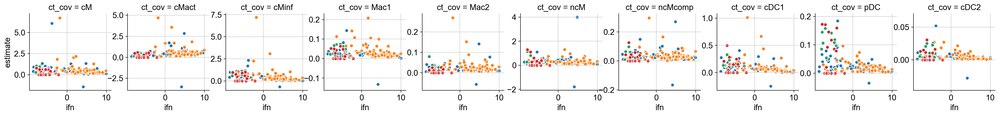

In [67]:
g = sb.FacetGrid(joined2, col="ct_cov",  hue="disease_pop_site_cov", aspect=0.8, height=3, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy, col_wrap=10)
g = g.map(plt.scatter, "ifn", "estimate", edgecolor="w")
g.fig.subplots_adjust(wspace=0.2)
g.savefig(figdir+"/ifn.ct_cov.estimates.png")

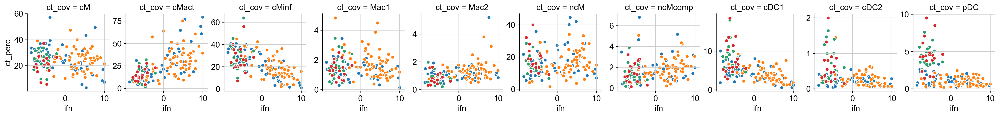

In [70]:
joined2_plot = joined2
joined2_plot.ct_cov = joined2_plot.ct_cov.astype('category')
joined2_plot.ct_cov = joined2_plot.ct_cov.cat.reorder_categories(['cM', 'cMact', 'cMinf', 'Mac1', 'Mac2', 'ncM', 'ncMcomp', 'cDC1', 'cDC2', 'pDC'])

g = sb.FacetGrid(joined2_plot, col="ct_cov",  hue="disease_pop_site_cov", aspect=0.8, height=3, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy, col_wrap=10)
g = g.map(plt.scatter, "ifn", "ct_perc", edgecolor="w")
g.fig.subplots_adjust(wspace=0.2)
g.savefig(figdir+"/ifn.ct_cov.png")

# SLEDAI analysis

In [73]:
joined2.sledaiscore = joined2.sledaiscore.fillna(0)
joined2.sliccscore = joined2.sliccscore.fillna(0)
joined2.ifn = joined2.ifn.fillna(0)

In [74]:
joined_pivot3_percs = joined2.pivot_table(index=['name',"disease_pop_site_cov","sledaiscore","sliccscore"], columns="ct_cov", values="ct_perc")

In [75]:
index_df = joined_pivot3_percs.index.to_frame(index=False)
df = joined_pivot3_percs.reset_index(drop=True)
joined_pivot3_percs = pd.merge(index_df, df, left_index=True, right_index=True)

In [77]:
print("Regression with all individuals with healthy controls set to 0 SLEDAI")
for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    
    est=sm.OLS(joined_pivot3_percs.sledaiscore.astype(float),  sm.add_constant(joined_pivot3_percs[ct].astype(float)), missing="drop")
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    r2=est.rsquared
    cor = joined_pivot3_percs.sledaiscore.corr(joined_pivot3_percs[ct])
    print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval)+', cor='+str(cor))
    
print("\nRegression with SLE only individuals")

for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    
    sle_only = joined_pivot3_percs[joined_pivot3_percs.disease_pop_site_cov.str.contains("sle")]
    
    est=sm.OLS(sle_only.sledaiscore.astype(float),  sm.add_constant(sle_only[ct].astype(float)), missing="drop")
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    r2=est.rsquared
    cor = sle_only.sledaiscore.corr(sle_only[ct])
    print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval)+', cor='+str(cor))
    
    
print("\nRegression with SLE asian individuals")

for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    
    sle_only = joined_pivot3_percs[joined_pivot3_percs.disease_pop_site_cov.str.contains("sleASIANUCSF")]
    
    est=sm.OLS(sle_only.sledaiscore.astype(float),  sm.add_constant(sle_only[ct].astype(float)), missing="drop")
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    r2=est.rsquared
    cor = sle_only.sledaiscore.corr(sle_only[ct])
    print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval)+', cor='+str(cor))
    
print("\nRegression with SLE white individuals")

for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    
    sle_only = joined_pivot3_percs[joined_pivot3_percs.disease_pop_site_cov.str.contains("sleWHITEUCSF")]
    
    est=sm.OLS(sle_only.sledaiscore.astype(float),  sm.add_constant(sle_only[ct].astype(float)), missing="drop")
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    r2=est.rsquared
    cor = sle_only.sledaiscore.corr(sle_only[ct])
    print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval)+', cor='+str(cor))

Regression with all individuals with healthy controls set to 0 SLEDAI
Cluster=cM, Beta=-0.024309663929358197, R2=0.005917779199241524, pvalue=0.33670040893610875, cor=-0.07692710315124113
Cluster=cMact, Beta=0.07505704720805126, R2=0.18983247977096307, pvalue=1.0551073779136095e-08, cor=0.4356976930980505
Cluster=cMinf, Beta=-0.07954090231915709, R2=0.1105041040329382, pvalue=1.9786069226948237e-05, cor=-0.3324215757632743
Cluster=Mac1, Beta=-0.37609480766208503, R2=0.011697733713204261, pvalue=0.17755522627741138, cor=-0.10815606184215595
Cluster=Mac2, Beta=0.7775260208640098, R2=0.029722023515394658, pvalue=0.03138886300372741, cor=0.17240076425409162
Cluster=ncM, Beta=-0.04273815764147389, R2=0.015003317558160312, pvalue=0.12522547175768198, cor=-0.12248803026483981
Cluster=ncMcomp, Beta=0.20995377668097193, R2=0.007020234955747773, pvalue=0.29525488728813404, cor=0.08378684237843077
Cluster=cDC1, Beta=-0.2546785240341641, R2=0.0780399920419369, pvalue=0.0003785407872843957, cor=-0.

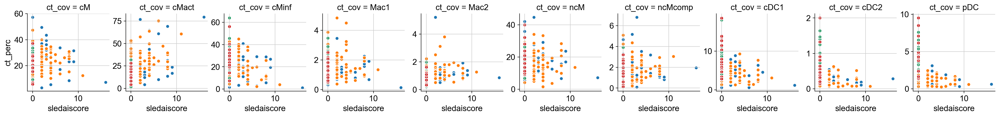

In [79]:
joined3_plot = joined2
joined3_plot.ct_cov = joined3_plot.ct_cov.astype('category')
##joined3_plot.ct_cov = joined3_plot.ct_cov.cat.reorder_categories(['cM', 'iM', 'ncM', 'actM', 'compM', 'Mac1', 'Mac2', 'cDC1', 'cDC2', 'pDC'])

g = sb.FacetGrid(joined3_plot, col="ct_cov",  hue="disease_pop_site_cov", aspect=0.8, height=3, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy, col_wrap=10)
g = g.map(plt.scatter, "sledaiscore", "ct_perc", edgecolor="w")
g.fig.subplots_adjust(wspace=0.2)
g.savefig(figdir+"/sledaiscore.ct_cov.png")

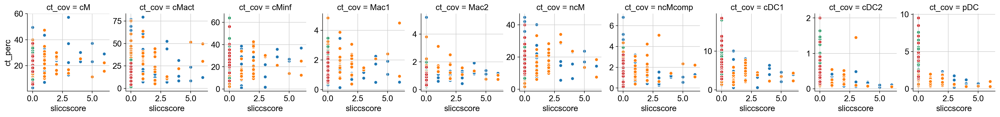

In [80]:
joined3_plot = joined2
joined3_plot.ct_cov = joined3_plot.ct_cov.astype('category')
##joined3_plot.ct_cov = joined3_plot.ct_cov.cat.reorder_categories(['cM', 'iM', 'ncM', 'actM', 'compM', 'Mac1', 'Mac2', 'cDC1', 'cDC2', 'pDC'])

g = sb.FacetGrid(joined3_plot, col="ct_cov",  hue="disease_pop_site_cov", aspect=0.8, height=3, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy, col_wrap=10)
g = g.map(plt.scatter, "sliccscore", "ct_perc", edgecolor="w")
g.fig.subplots_adjust(wspace=0.2)
g.savefig(figdir+"/sliccscore.ct_cov.png")

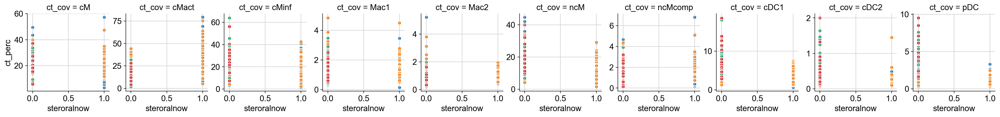

In [81]:
joined3_plot = joined2
joined3_plot.ct_cov = joined3_plot.ct_cov.astype('category')
##joined3_plot.ct_cov = joined3_plot.ct_cov.cat.reorder_categories(['cM', 'iM', 'ncM', 'actM', 'compM', 'Mac1', 'Mac2', 'cDC1', 'cDC2', 'pDC'])

g = sb.FacetGrid(joined3_plot, col="ct_cov",  hue="disease_pop_site_cov", aspect=0.8, height=3, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy, col_wrap=10)
g = g.map(plt.scatter, "steroralnow", "ct_perc", edgecolor="w")
g.fig.subplots_adjust(wspace=0.2)

# Let's recompute the IFN score

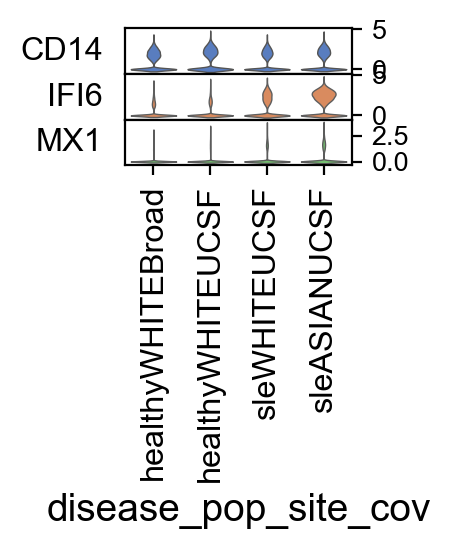

In [82]:
sc.pl.stacked_violin(adata, var_names=['CD14',"IFI6","MX1"], groupby='disease_pop_site_cov', swap_axes=True)

In [83]:
diffexp_annot = pd.read_csv("diffexp.annotations.txt", sep="\t", index_col=False)
##diffexp_annot.cluster = diffexp_annot.cluster.astype("category")

## remap the categories
# diffexp_annot.cluster[diffexp_annot.cluster == "Pan2"] = "CPan";
# diffexp_annot.cluster[diffexp_annot.cluster == "Pan1"] = "CLymph";
# diffexp_annot.cluster[diffexp_annot.cluster == "Down"] = "CT1";
# diffexp_annot.cluster[diffexp_annot.cluster == "Myeloid1"] = "CMye1";
# diffexp_annot.cluster[diffexp_annot.cluster == "Myeloid2"] = "CMye2";
# diffexp_annot.cluster[diffexp_annot.cluster == "M"] = "CMono";
# diffexp_annot.cluster[diffexp_annot.cluster == "T1"] = "CT2";
# diffexp_annot.cluster[diffexp_annot.cluster == "T2"] = "CT3";
diffexp_annot.cluster = diffexp_annot.cluster.astype("category")

In [84]:
for cluster_i in diffexp_annot.cluster.cat.categories:
    print(cluster_i)
    cluster_X = adata.X[:,adata.var_names.isin(diffexp_annot.gene[diffexp_annot.cluster==cluster_i])];
    adata.obs[cluster_i] = np.sum(cluster_X, axis=1)
    

Misc
Mono
Pan
T4
T8_1
T8_2
ncM
pDC


saving figure to file ./figures.V6/umap.ifn.sle.png
saving figure to file ./figures.V6/umap.ifn.healthy.png


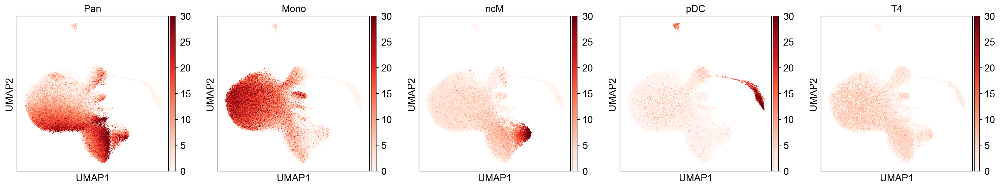

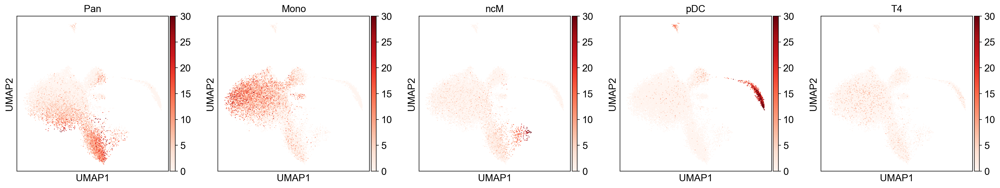

In [86]:
##fig,ax = plt.subplots(nrows=1,ncols=2, figsize=(10,5),sharex=True, sharey=True)
##fig.tight_layout()

sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['Pan',"Mono", "ncM", "pDC", "T4"], size=5, vmin=0, color_map=plt.cm.Reds, vmax=30, ncols=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[(adata.obs.disease_cov=="healthy") & (adata.obs.Broad == 0)], color=['Pan',"Mono", "ncM", "pDC", "T4"], color_map=plt.cm.Reds, size=5, vmin=0, vmax=30, ncols=5) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
# sc.pl.umap(adata[(adata.obs.disease_cov=="healthy") & (adata.obs.Broad == 1)], color=['all_ifn',"myeloid_ifn","cM_ifn"], palette="Greys", size=10) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)

sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['Pan',"Mono", "ncM", "pDC", "T4"], size=5, save='.ifn.sle.png', color_map=plt.cm.Reds,vmin=0, vmax=30, ncols=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[(adata.obs.disease_cov=="healthy") & (adata.obs.Broad == 0)], color=['Pan',"Mono", "ncM", "pDC", "T4"], size=5, color_map=plt.cm.Reds,save='.ifn.healthy.png', vmin=0, vmax=30, ncols=5) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)


##sc.pl.umap(adata[adata.obs.disease_cov=="healthy",], color = "all_ifn", ax=ax[1])                                                      

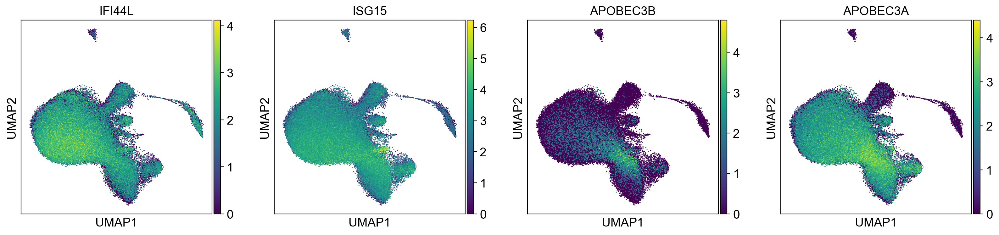

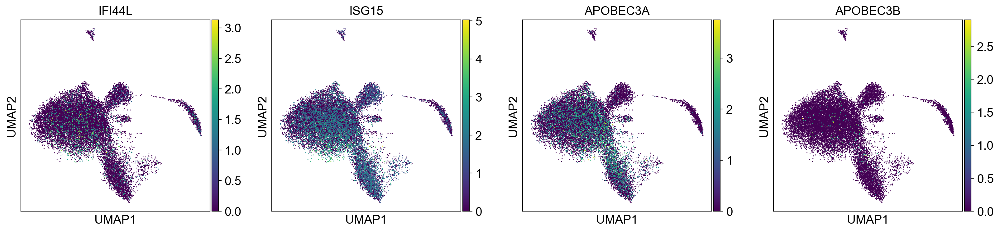

In [87]:
##fig,ax = plt.subplots(nrows=1,ncols=2, figsize=(10,5),sharex=True, sharey=True)
##fig.tight_layout()

sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['IFI44L',"ISG15","APOBEC3B","APOBEC3A"], size=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[(adata.obs.disease_cov=="healthy") & (adata.obs.Broad == 0)], color=['IFI44L',"ISG15","APOBEC3A","APOBEC3B"], size=5) ##,vmin=min(adata.obs.all_ifn), vmax=maex(adata.obs.all_ifn)*.75)
##sc.pl.umap(adata[(adata.obs.disease_cov=="healthy") & (adata.obs.Broad == 1)], color=['IFI44L',"ISG15","APOBEC3B"], size=10) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)



##sc.pl.umap(adata[adata.obs.disease_cov=="healthy",], color = "all_ifn", ax=ax[1])                                                      

saving figure to file ./figures.V6/umap.types.png


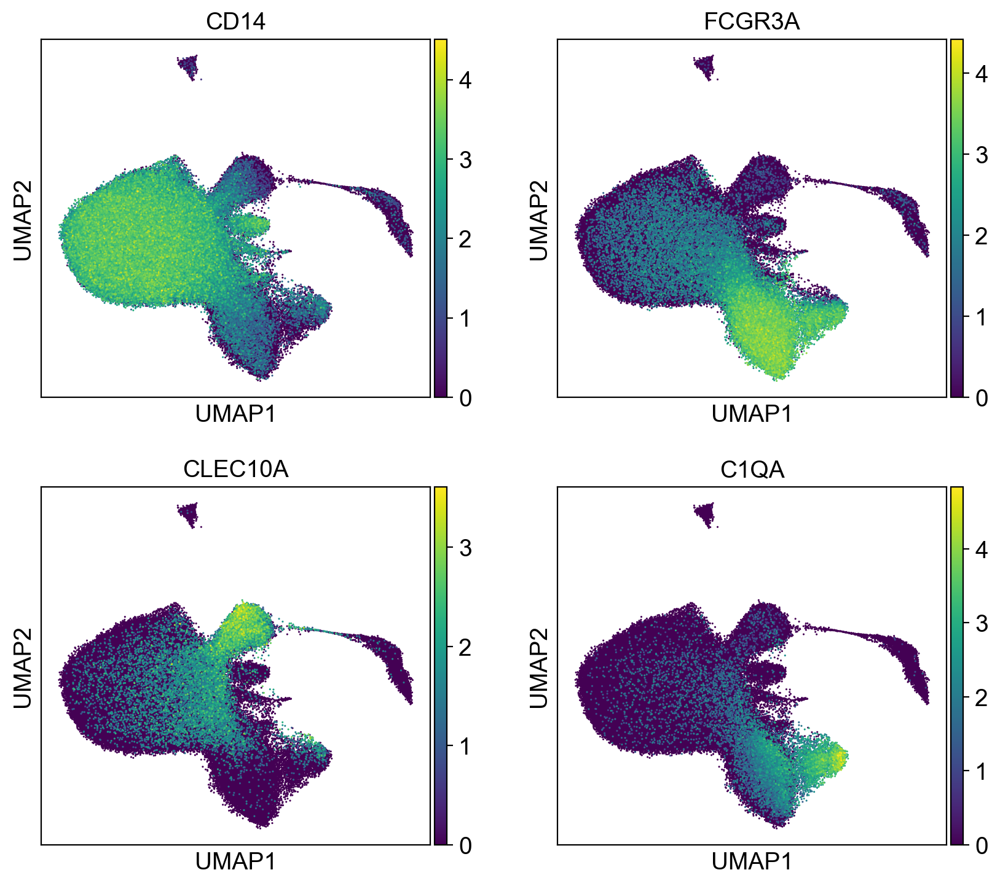

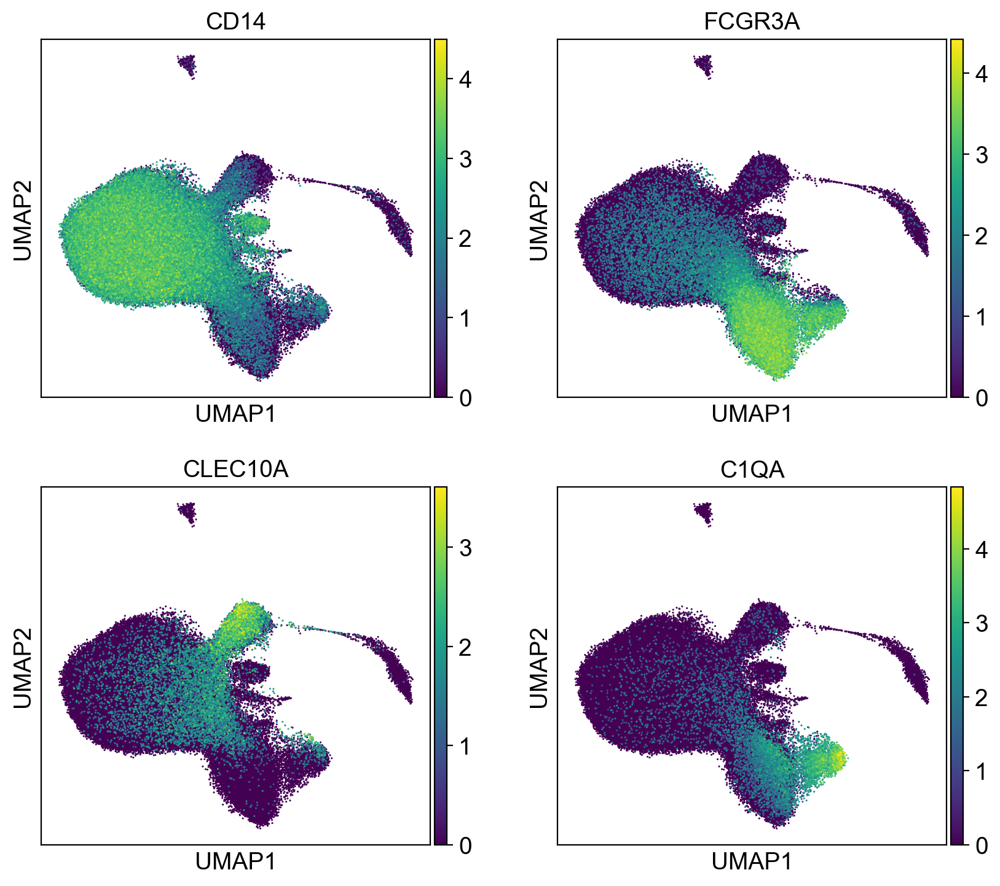

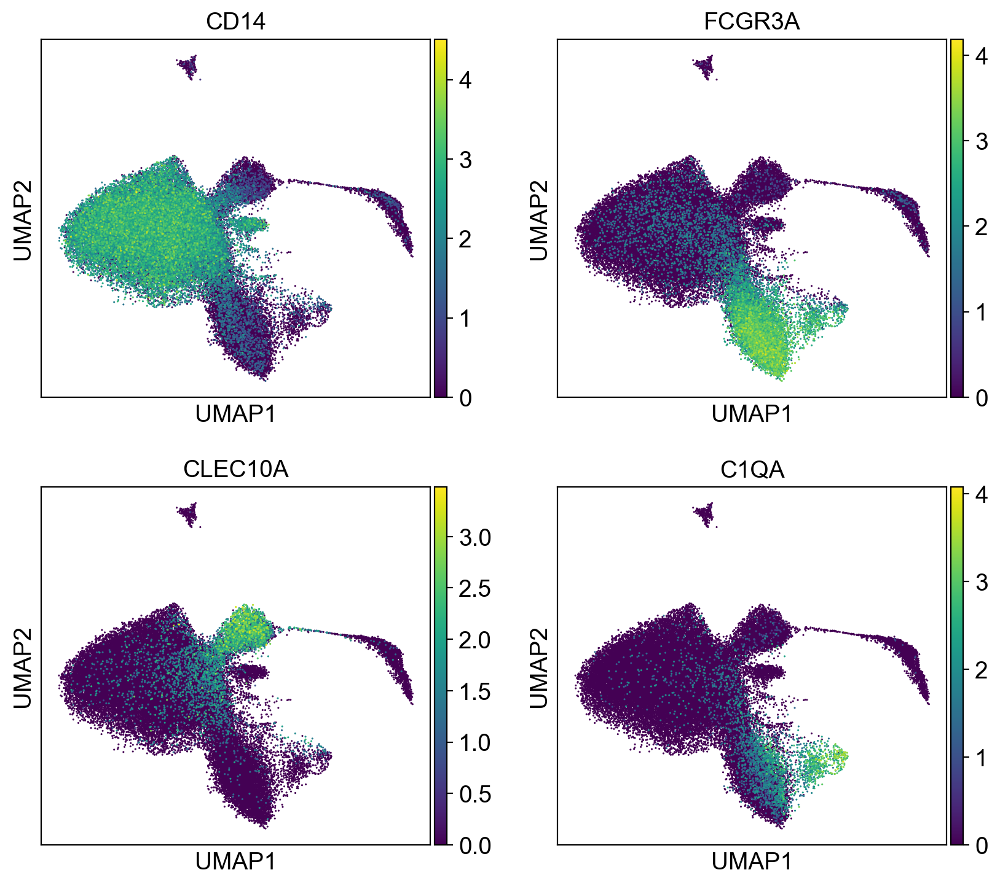

In [88]:
markers = sc.pl.umap(adata, color=['CD14',"FCGR3A","CLEC10A","C1QA"], palette="Greys", size=5,ncols=2) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata, color=['CD14',"FCGR3A","CLEC10A","C1QA"], palette="Greys", size=5, save='.types.png',ncols=2)
sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['CD14',"FCGR3A","CLEC10A","C1QA"], palette="Greys", size=5,ncols=2) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[adata.obs.disease_cov=="healthy"], color=['CD14',"FCGR3A","CLEC10A","C1QA"], palette="Greys", size=5,ncols=2) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)

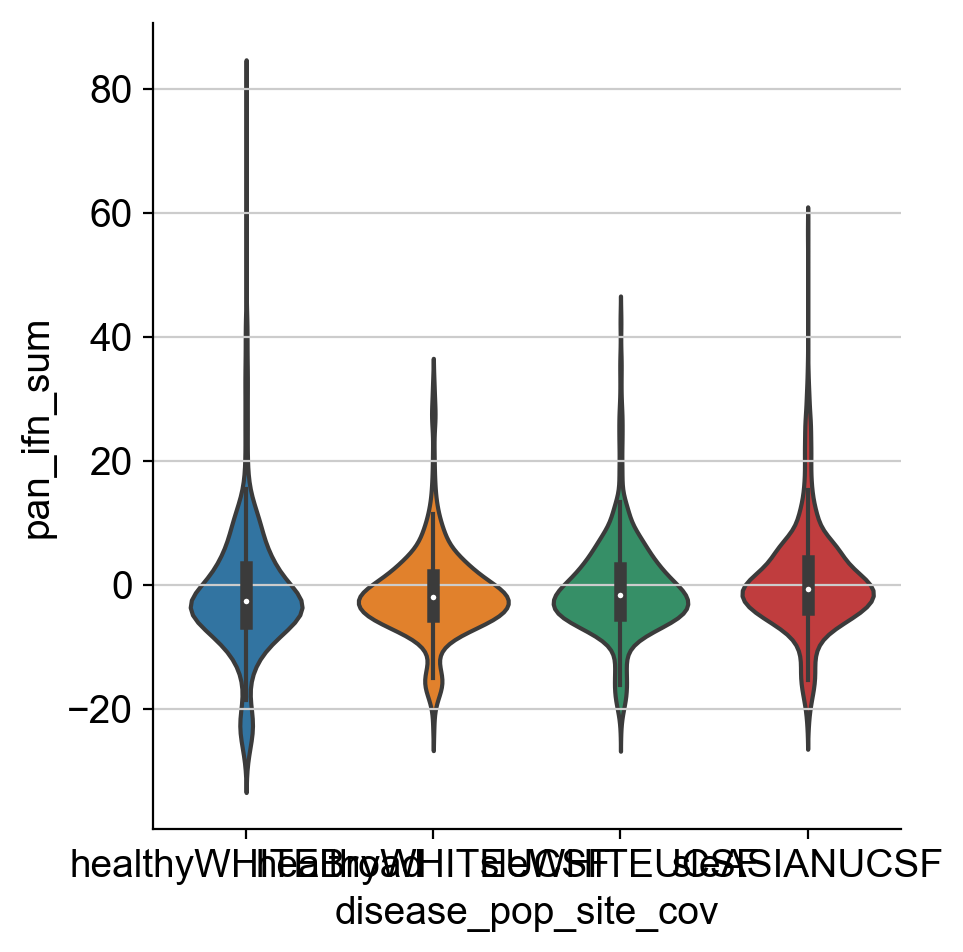

In [89]:
plot_df = adata.obs.groupby(['ind_cov','disease_pop_site_cov','louvain'])['Pan'].mean()
plot_df = plot_df.reset_index(name='pan_ifn_sum')

sb.catplot(x="disease_pop_site_cov", y="pan_ifn_sum", data=plot_df, kind='violin', dodge=False, sharex=False, sharey=True)

Cluster=0,Beta=-0.6057103520080813, pvalue=0.16044372926398984
Cluster=1,Beta=-1.6444841501191887, pvalue=6.928027096475724e-07
Cluster=2,Beta=0.7628695104402661, pvalue=0.14206737698005395
Cluster=3,Beta=-1.7401393210712597, pvalue=8.89996838163361e-05
Cluster=4,Beta=-0.5990963151263599, pvalue=0.37716015282666904
Cluster=5,Beta=-1.6863089707168204, pvalue=6.0205702733705086e-05
Cluster=6,Beta=-0.5643304080923064, pvalue=0.35475260362560523
Cluster=7,Beta=-3.6753462134088783, pvalue=1.3897950217762363e-10


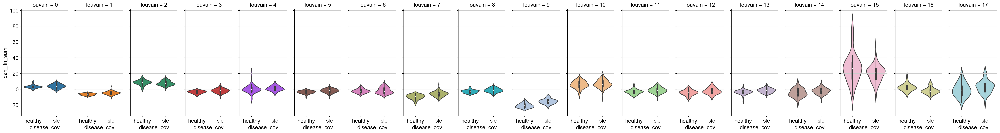

In [90]:
plot_df = adata.obs.groupby(['ind_cov','disease_cov','louvain'])['Pan'].mean()
plot_df = plot_df.reset_index(name='pan_ifn_sum')

sb.catplot(x="disease_cov", y="pan_ifn_sum", hue='louvain', data=plot_df, kind='violin', col='louvain', dodge=False, aspect=0.4, sharex=False, sharey=True)

##n_cts=ct_df.shape[1]-1
for cluster_i in list(range(0,8)):
    cluster = plot_df.louvain.cat.categories[cluster_i]
    pan_ifn_sum = plot_df.pan_ifn_sum[plot_df.louvain == cluster]
    disease = plot_df.disease_cov[plot_df.louvain==cluster].astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    est=sm.OLS(pan_ifn_sum.astype(float), disease.astype(float), missing='drop')
    ##est=sm.OLS("all_ifn~disease_cov", data=adata.obs.input,missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    print('Cluster='+str(cluster)+',Beta='+str(effect)+', pvalue='+str(pval))

Cluster=0,Beta=-0.7255663615173344, pvalue=0.051643600730981946
Cluster=1,Beta=-1.5365028163174754, pvalue=2.735980503025029e-07
Cluster=2,Beta=0.4651510967521302, pvalue=0.32416669396330056
Cluster=3,Beta=-1.630176384932498, pvalue=3.59195958273772e-05
Cluster=4,Beta=-0.6012497563988435, pvalue=0.3323631628321463
Cluster=5,Beta=-1.654346110457795, pvalue=2.3405444480133313e-05
Cluster=6,Beta=-0.7213271660030411, pvalue=0.17455460923912783
Cluster=7,Beta=-3.39754712939509, pvalue=3.109369083631871e-11


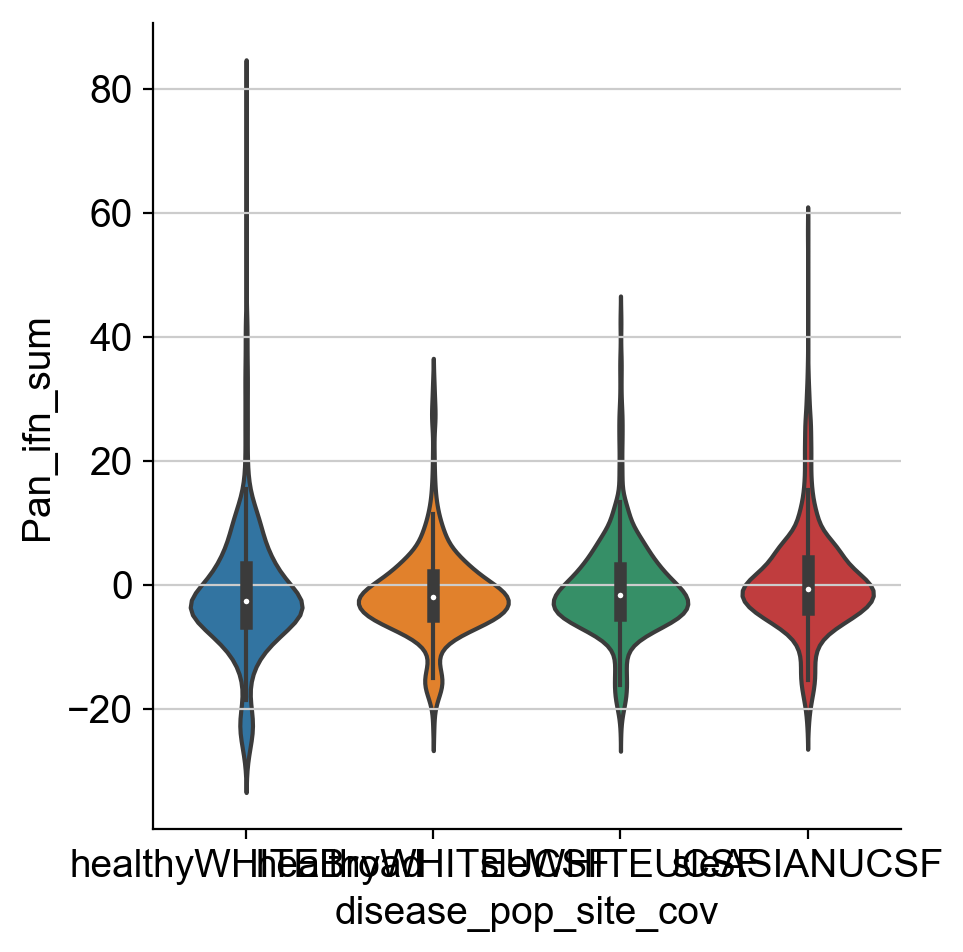

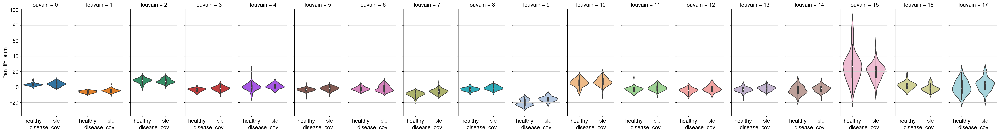

In [98]:
plot_df = adata.obs.groupby(['ind_cov','disease_pop_site_cov','disease_cov','louvain'])['Pan'].mean()
plot_df = plot_df.reset_index(name='Pan_ifn_sum')

sb.catplot(x="disease_pop_site_cov", y="Pan_ifn_sum", data=plot_df, kind='violin', dodge=False, sharex=False, sharey=True)
sb.catplot(x="disease_cov", y="Pan_ifn_sum", hue='louvain', data=plot_df, kind='violin', col='louvain', dodge=False, aspect=0.4, sharex=False, sharey=True)

##n_cts=ct_df.shape[1]-1
for cluster_i in list(range(0,8)):
    cluster = plot_df.louvain.cat.categories[cluster_i]
    Pan_ifn_sum = plot_df.Pan_ifn_sum[plot_df.louvain == cluster]
    disease = plot_df.disease_cov[plot_df.louvain==cluster].astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    est=sm.OLS(Pan_ifn_sum.astype(float), disease.astype(float), missing='drop')
    ##est=sm.OLS("myeloid_ifn~disease_cov", data=adata.obs.input,missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    print('Cluster='+str(cluster)+',Beta='+str(effect)+', pvalue='+str(pval))

Cluster=0,Beta=-1.4642286669688227, pvalue=3.4912547637998295e-10
Cluster=1,Beta=-1.8156230239223239, pvalue=5.785490167345602e-10
Cluster=2,Beta=-0.11085232837331377, pvalue=0.6797954535636798
Cluster=3,Beta=-1.4291348033258555, pvalue=5.265530449621012e-07
Cluster=4,Beta=-1.5334912603933757, pvalue=0.007680306819249445
Cluster=5,Beta=-0.916893024945314, pvalue=0.004614146138704092
Cluster=6,Beta=0.10270917235570005, pvalue=0.7458649399397568
Cluster=7,Beta=-1.8529072598352692, pvalue=3.198345602219464e-05


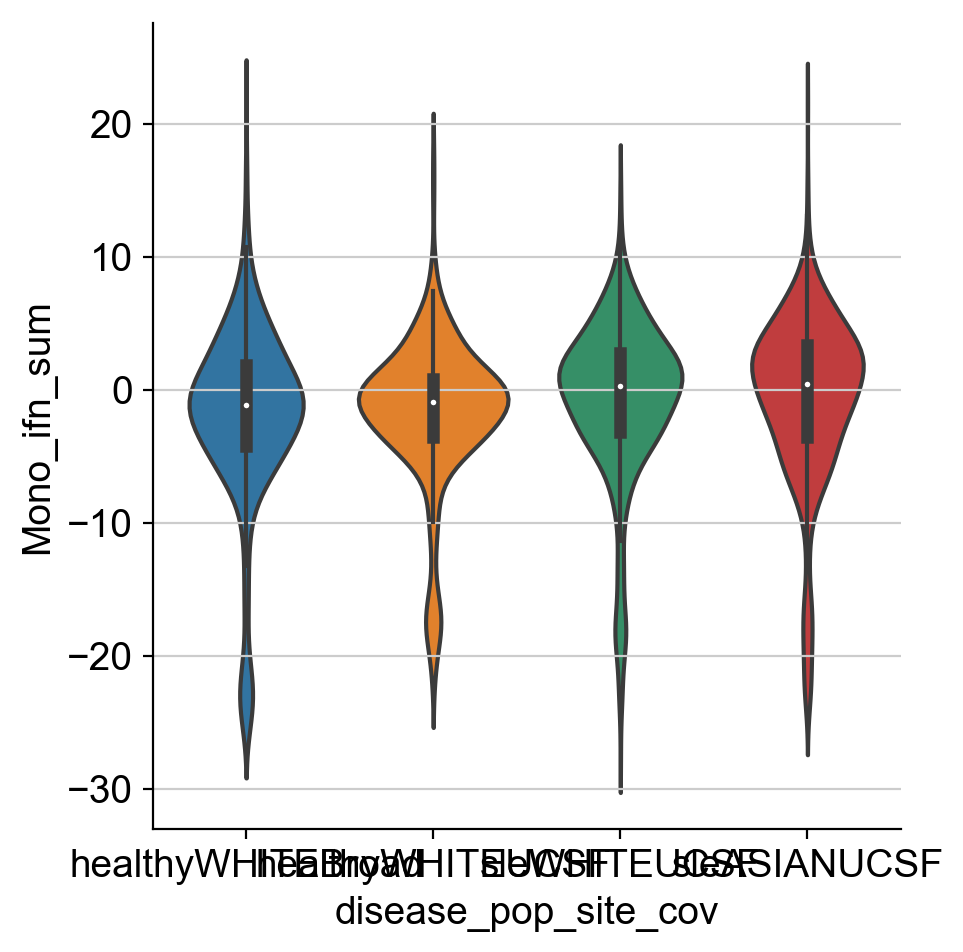

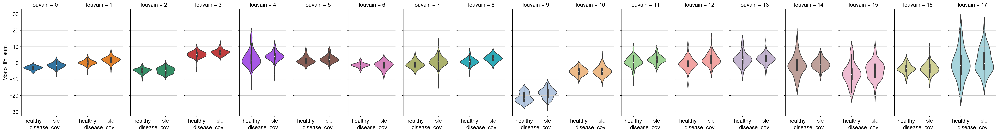

In [101]:
plot_df = adata.obs.groupby(['ind_cov','disease_pop_site_cov','disease_cov','louvain'])['Mono'].mean()
plot_df = plot_df.reset_index(name='Mono_ifn_sum')

sb.catplot(x="disease_pop_site_cov", y="Mono_ifn_sum", data=plot_df, kind='violin', dodge=False, sharex=False, sharey=True)
sb.catplot(x="disease_cov", y="Mono_ifn_sum", hue='louvain', data=plot_df, kind='violin', col='louvain', dodge=False, aspect=0.4, sharex=False, sharey=True)

##n_cts=ct_df.shape[1]-1
for cluster_i in list(range(0,8)):
    cluster = plot_df.louvain.cat.categories[cluster_i]
    Mono_ifn_sum = plot_df.Mono_ifn_sum[plot_df.louvain == cluster]
    disease = plot_df.disease_cov[plot_df.louvain==cluster].astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    est=sm.OLS(Mono_ifn_sum.astype(float), disease.astype(float), missing='drop')
    ##est=sm.OLS("myeloid_ifn~disease_cov", data=adata.obs.input,missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    print('Cluster='+str(cluster)+',Beta='+str(effect)+', pvalue='+str(pval))

## Let's now do DPT

In [102]:
## let's just get a smaller dataset
adata_mono = adata[~adata.obs.ct_cov.isin(["cDC1",'cDC2','pDC','Mac1','Mac2',"cMact",'cMinf','ncMcomp'])].copy()

In [103]:
sc.tl.pca(adata_mono, svd_solver='arpack')

computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:10.09)


In [104]:
## denoise
sc.tl.diffmap(adata_mono)
sc.pp.neighbors(adata_mono, n_neighbors=10, use_rep='X_diffmap')

computing Diffusion Maps using n_comps=15(=n_dcs)
    eigenvalues of transition matrix
    [ 1.          0.9956825   0.957957    0.94207734  0.9415132   0.92308956
      0.9189242   0.91412514  0.91031706  0.90153635  0.89795405  0.89595866
     -0.9006326  -0.91071236 -0.9414245 ]
    finished (0:00:02.57)
computing neighbors


/Users/yimmieg/anaconda3/lib/python3.6/site-packages/umap/rp_tree.py:450: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "make_euclidean_tree" failed type inference due to: Cannot unify RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none) and RandomProjectionTreeNode(none, bool, array(float32, 1d, C), float64, RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none), RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none)) for '$14.16', defined at /Users/yimmieg/anaconda3/lib/python3.6/site-packages/umap/rp_tree.py (457)

File "../../../../../../../anaconda3/lib/python3.6/site-packages/umap/rp_tree.py", line 457:
def make_euclidean_tree(data, indices, rng_state, leaf_size=30):
    <source elided>

        left_node = make_euclidean_tree(data, left_indices, rng_state, leaf_size)
        ^

[1] During: resolving callee type: recursive(type(CPUDispatcher(<function make_euclid

    finished (0:00:21.57)


In [105]:
sc.tl.louvain(adata_mono, resolution=1.0)
sc.tl.paga(adata_mono, groups='louvain')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:07.72)
running PAGA
    finished (0:00:04.57)


    number of colors in `.uns[louvain'_colors']` smaller than number of categories, falling back to palette


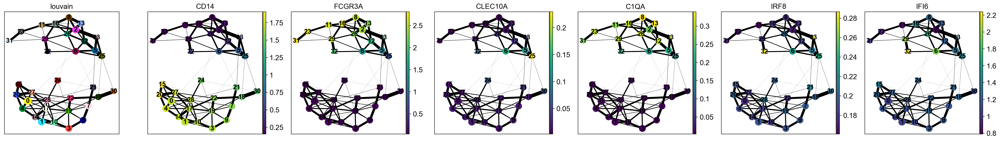

In [106]:
sc.pl.paga(adata_mono, color=['louvain', 'CD14',"FCGR3A","CLEC10A", 'C1QA', 'IRF8', 'IFI6'])

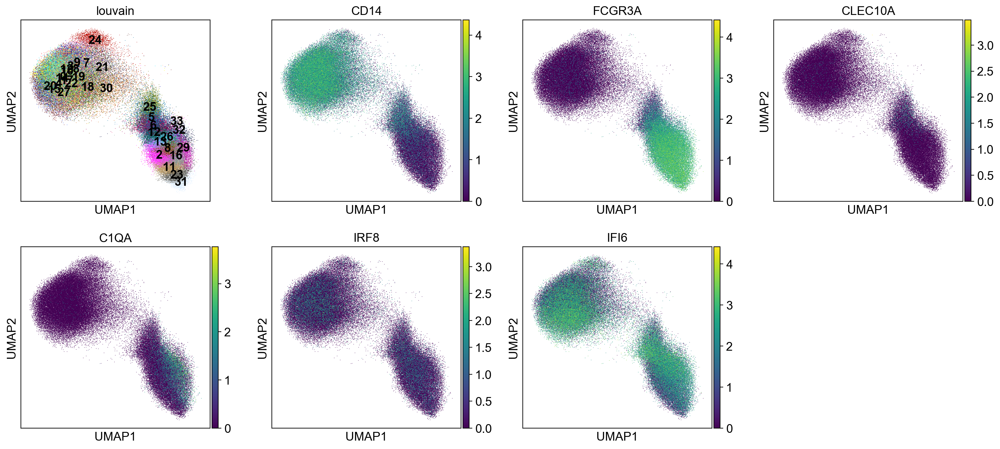

In [107]:
sc.pl.umap(adata_mono, color=['louvain', 'CD14',"FCGR3A","CLEC10A", 'C1QA', 'IRF8', 'IFI6'], legend_loc='on data')

In [108]:
# sc.tl.draw_graph(adata_mono, init_pos='paga')
# sc.pl.draw_graph(adata_mono, color=['louvain', 'CD14',"FCGR3A","CLEC10A", 'C1QA', 'IRF8', 'IFI6'], legend_loc='on data')

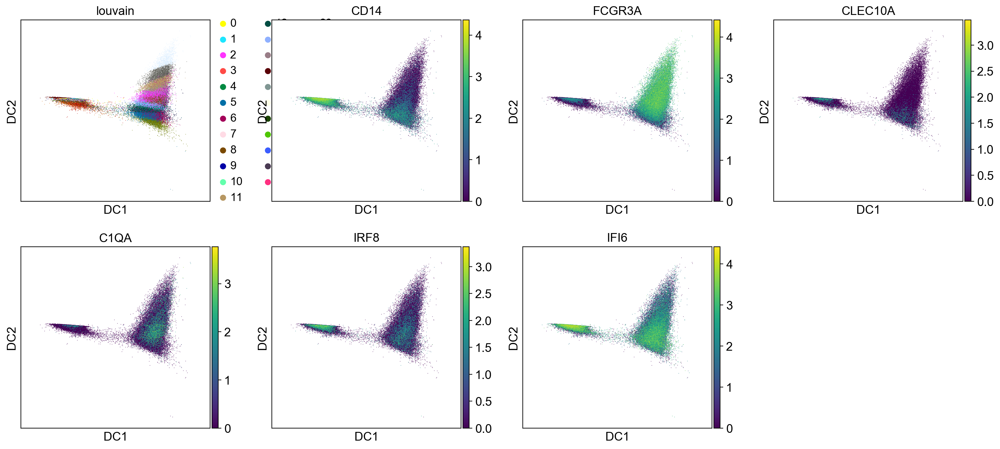

In [109]:
sc.pl.diffmap(adata_mono, color=['louvain', 'CD14',"FCGR3A","CLEC10A", 'C1QA', 'IRF8', 'IFI6'])

In [110]:
adata_mono.uns['iroot'] = np.flatnonzero((adata_mono.obs['louvain']  == '17') | (adata_mono.obs['louvain']  == '14'))[0]
sc.tl.dpt(adata_mono, n_dcs=15)

computing Diffusion Pseudotime using n_dcs=15
    finished (0:00:00.01)


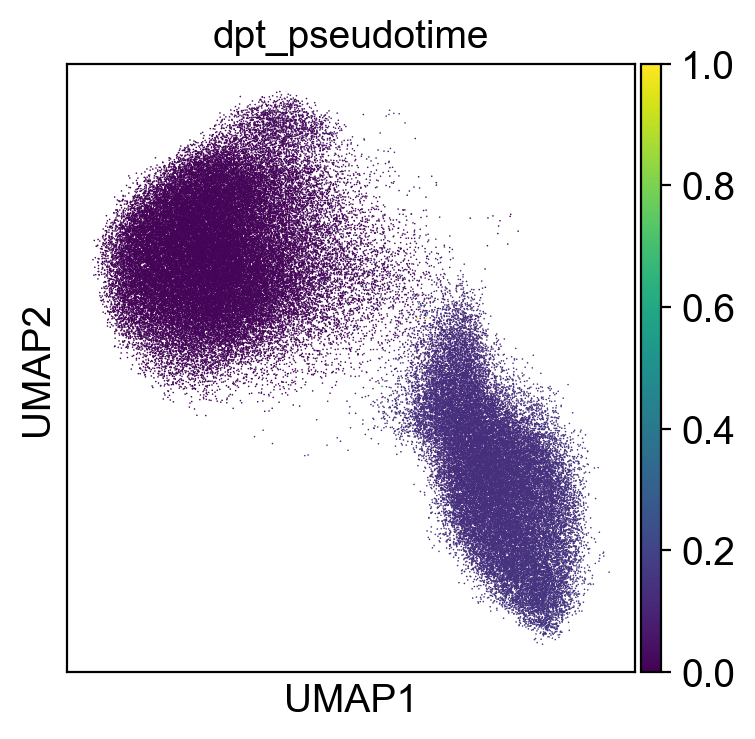

In [111]:
sc.pl.umap(adata_mono, color=['dpt_pseudotime'], legend_loc='on data')

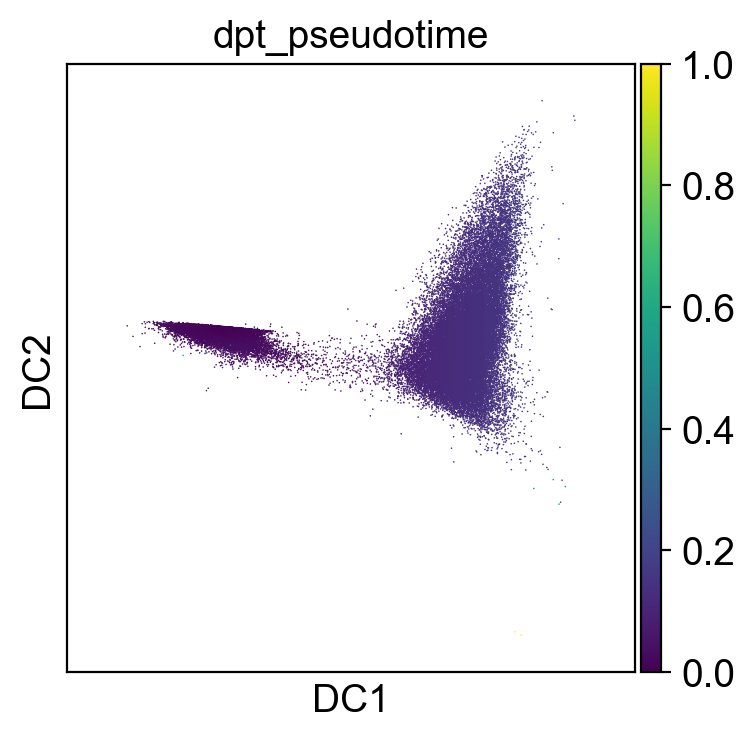

In [112]:
sc.pl.diffmap(adata_mono, color=['dpt_pseudotime'])

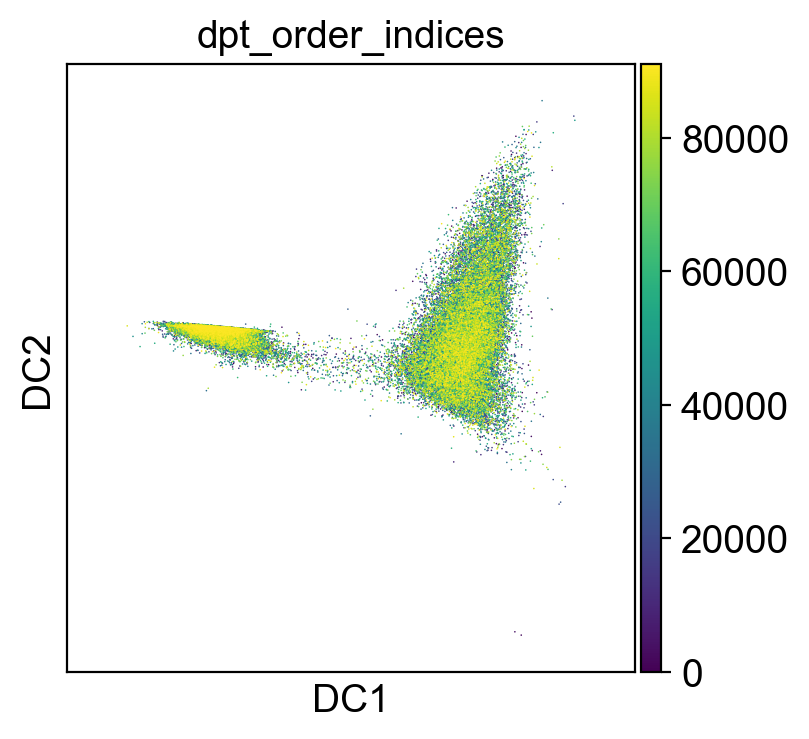

In [113]:
adata_mono.obs['dpt_order_indices'] = adata_mono.obs['dpt_pseudotime'].argsort()
adata_mono.uns['dpt_changepoints'] = np.ones(adata_mono.obs['dpt_order_indices'].shape[0] - 1)
sc.pl.diffmap(adata_mono, color=['dpt_order_indices'])

In [114]:
adata_mono_small = adata_mono[1:100,adata_mono.var_names.isin(["IFI6","MX1"])]

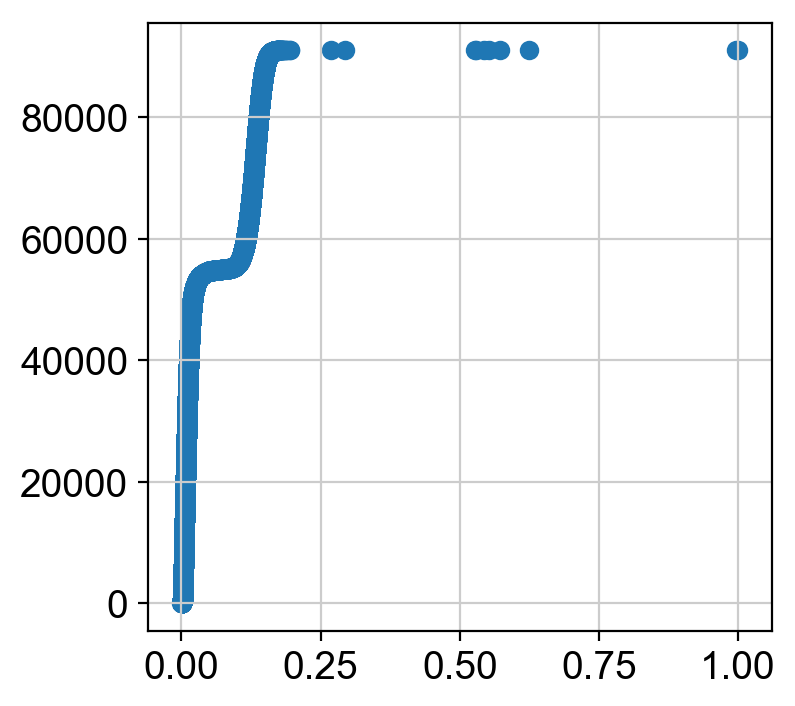

In [115]:
plt.scatter(adata_mono.obs['dpt_pseudotime'], adata_mono.obs['dpt_pseudotime'].rank())

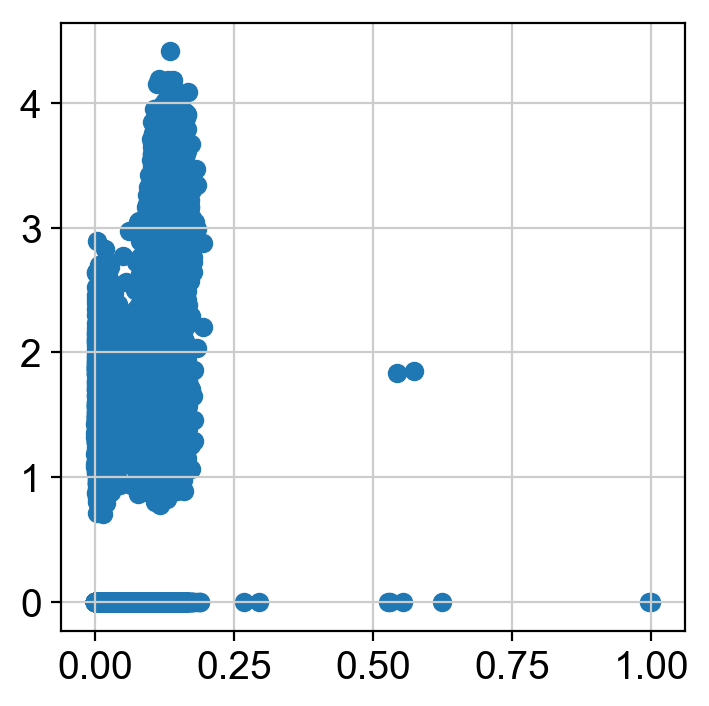

In [116]:
plt.scatter(adata_mono.obs['dpt_pseudotime'], adata_mono.raw[:,"FCGR3A"].X)

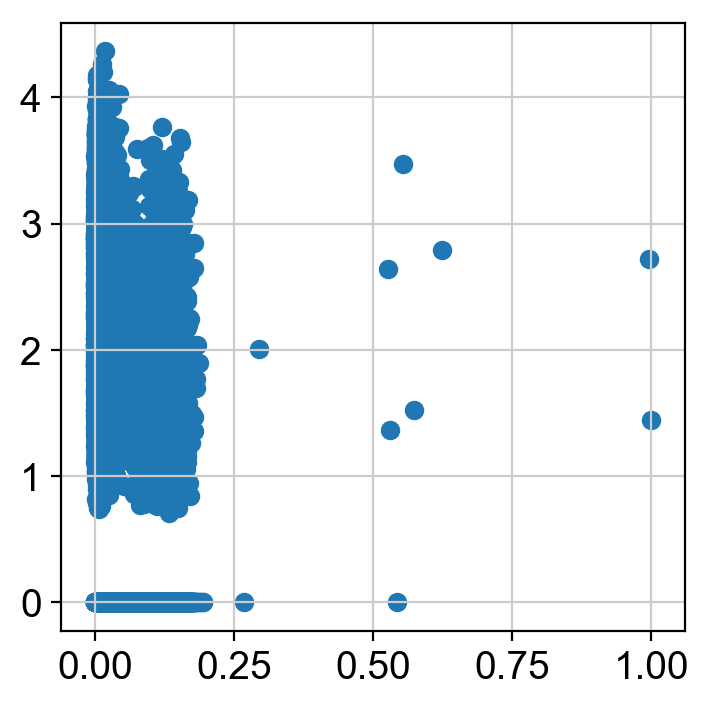

In [117]:
plt.scatter(adata_mono.obs['dpt_pseudotime'], adata_mono.raw[:,"CD14"].X)

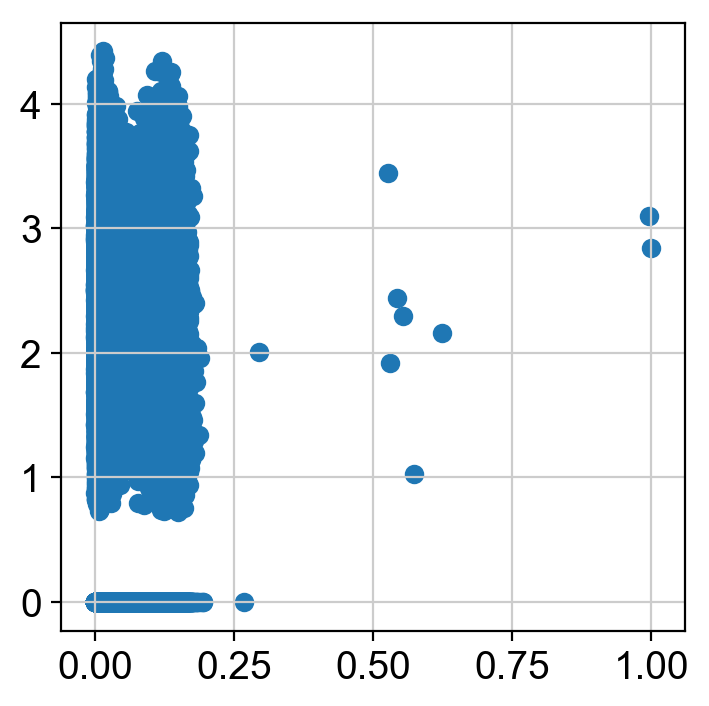

In [118]:
plt.scatter(adata_mono.obs['dpt_pseudotime'], adata_mono.raw[:,"IFI6"].X)

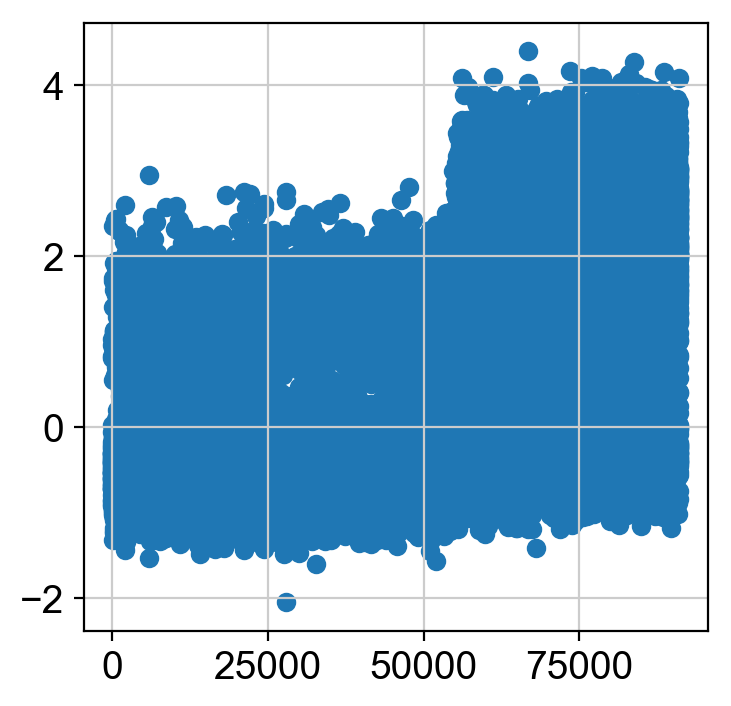

In [119]:
plt.scatter(adata_mono.obs['dpt_pseudotime'].rank(), adata_mono[:,"FCGR3A"].X)

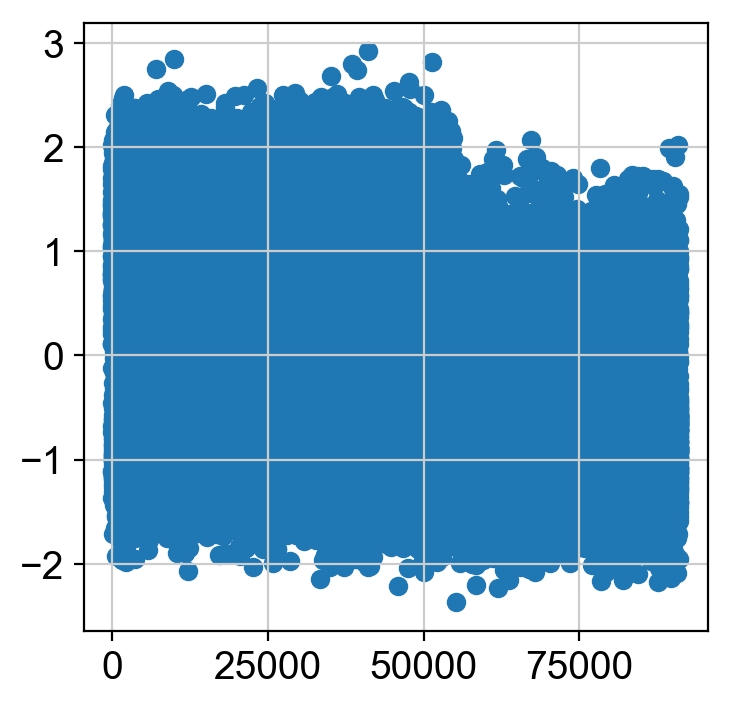

In [120]:
plt.scatter(adata_mono.obs['dpt_pseudotime'].rank(), adata_mono[:,"CD14"].X)

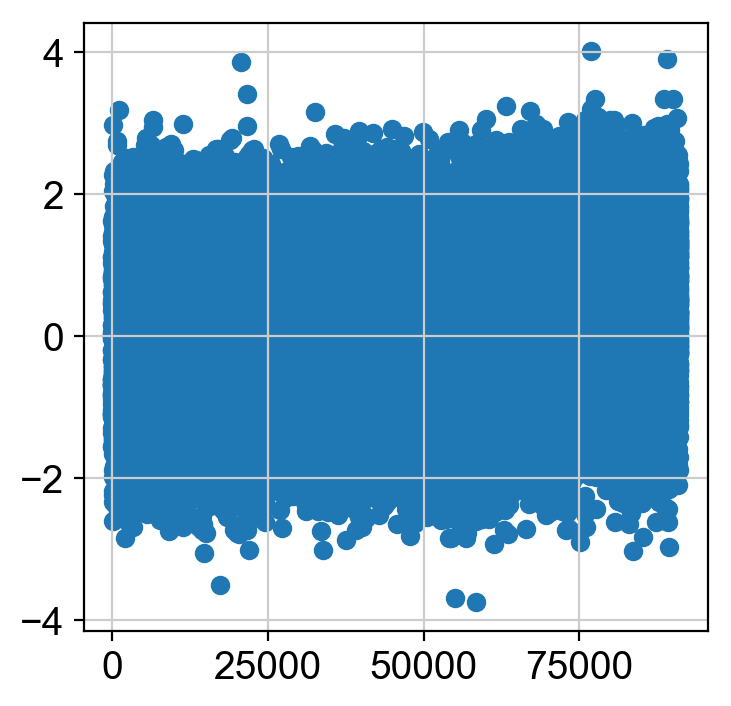

In [121]:
plt.scatter(adata_mono.obs['dpt_pseudotime'].rank(),adata_mono[:,"IFI6"].X)

In [122]:
diffexp_annot.cluster.unique()

[Pan, Mono, ncM, pDC, T4, T8_1, T8_2, Misc]
Categories (8, object): [Pan, Mono, ncM, pDC, T4, T8_1, T8_2, Misc]

In [133]:
PC = np.asarray(sc.pp.pca(data[:,genes_ncm_ifn].X, n_comps=1, copy=True)).reshape(-1,)
data.obs['PC_axis4'] = list(PC)


Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 1
    finished (0:00:00.22)


In [143]:
colors = ["#fee8c8","#fdbb84","#ef6548","#990000"]
data = adata.copy();

# Slice matrix to remove people not in Monocyte results
clues_clinical2 = pd.read_table("v2.clinical.data.txt", index_col=False)
clues_clinical2 = clues_clinical2[clues_clinical2['genotypeid'].isin(data.obs['ind_cov'].values.tolist())]
ifn_genes = pd.read_csv('ifn.lupus.crow.etal.txt', header=None)

genes_lineage = data.var_names[data.var_names.isin(['CD14', 'FCGR3A'])].tolist()
genes_pan_ifn = data.var_names[data.var_names.isin(diffexp_annot.gene[diffexp_annot.cluster.isin(["Pan"])])].tolist()
genes_mono_ifn = data.var_names[data.var_names.isin(diffexp_annot.gene[diffexp_annot.cluster.isin(["Mono"])])].tolist()
genes_ncm_ifn = data.var_names[data.var_names.isin(diffexp_annot.gene[diffexp_annot.cluster.isin(["ncM"])])].tolist()
genes_pdc_ifn = data.var_names[data.var_names.isin(diffexp_annot.gene[diffexp_annot.cluster.isin(["pDC"])])].tolist()
genes_ifn = data.var_names[data.var_names.isin(ifn_genes[0])].tolist()

# Order cells
PC = np.asarray(sc.pp.pca(data[:,genes_lineage].X, n_comps=1, copy=True)).reshape(-1,)
data.obs['PC_axis1'] = list(PC)
PC = np.asarray(sc.pp.pca(data[:,genes_pan_ifn].X, n_comps=1, copy=True)).reshape(-1,)
data.obs['PC_axis2'] = list(PC)
PC = np.asarray(sc.pp.pca(data[:,genes_mono_ifn].X, n_comps=1, copy=True)).reshape(-1,)
data.obs['PC_axis3'] = list(PC)
PC = np.asarray(sc.pp.pca(data[:,genes_ncm_ifn].X, n_comps=1, copy=True)).reshape(-1,)
data.obs['PC_axis4'] = list(-PC)
PC = np.asarray(sc.pp.pca(data[:,genes_pdc_ifn].X, n_comps=1, copy=True)).reshape(-1,)
data.obs['PC_axis5'] = list(PC)
##PC = np.asarray(sc.pp.pca(data[:,genes_monocytes_ifn].X, n_comps=1, copy=True)).reshape(-1,)
PC = np.asarray(sc.pp.pca(data[:,genes_ifn].X, n_comps=1, copy=True)).reshape(-1,)
data.obs['PC_axis6'] = list(PC)

ind_healthy = data.obs['ind_cov'][data.obs['disease_cov']=='healthy'].tolist()
healthyall_axis1 = np.asarray(data.obs['PC_axis1'][data.obs['ind_cov'].isin(ind_healthy)].values.tolist())
healthyall_axis2 = np.asarray(data.obs['PC_axis2'][data.obs['ind_cov'].isin(ind_healthy)].values.tolist())
healthyall_axis3 = np.asarray(data.obs['PC_axis3'][data.obs['ind_cov'].isin(ind_healthy)].values.tolist())
healthyall_axis4 = np.asarray(data.obs['PC_axis4'][data.obs['ind_cov'].isin(ind_healthy)].values.tolist())
healthyall_axis5 = np.asarray(data.obs['PC_axis5'][data.obs['ind_cov'].isin(ind_healthy)].values.tolist())
healthyall_axis6 = np.asarray(data.obs['PC_axis6'][data.obs['ind_cov'].isin(ind_healthy)].values.tolist())

# Some SLEDAI scores to cut at
SLEDAI = [np.percentile(clues_clinical2['sledaiscore'].tolist(),25), np.percentile(clues_clinical2['sledaiscore'].tolist(),50), np.percentile(clues_clinical2['sledaiscore'].tolist(),75), np.percentile(clues_clinical2['sledaiscore'].tolist(),100)]
print(SLEDAI)
##colors = ['r', 'g', 'k', 'y', 'm']
sleall_axis1 = {};
sleall_axis2 = {};
sleall_axis3 = {};
sleall_axis4 = {};
sleall_axis5 = {};
sleall_axis6 = {};

for ii in range(len(SLEDAI)):
    if ii == SLEDAI[0]:
        disease_sub = clues_clinical2['genotypeid'][clues_clinical2['sledaiscore'] <= SLEDAI[ii]]
    else:
        disease_sub = clues_clinical2['genotypeid'][(clues_clinical2['sledaiscore'] <= SLEDAI[ii]) & (clues_clinical2['sledaiscore'] > SLEDAI[ii-1])]

    ind_sle = data.obs['ind_cov'][data.obs['ind_cov'].isin(disease_sub.values.tolist())].tolist()
    
    sleall_axis1[str(ii)] = np.asarray(data.obs['PC_axis1'][data.obs['ind_cov'].isin(ind_sle)].values.tolist())
    sleall_axis2[str(ii)] = np.asarray(data.obs['PC_axis2'][data.obs['ind_cov'].isin(ind_sle)].values.tolist())
    sleall_axis3[str(ii)] = np.asarray(data.obs['PC_axis3'][data.obs['ind_cov'].isin(ind_sle)].values.tolist())
    sleall_axis4[str(ii)] = np.asarray(data.obs['PC_axis4'][data.obs['ind_cov'].isin(ind_sle)].values.tolist())
    sleall_axis5[str(ii)] = np.asarray(data.obs['PC_axis5'][data.obs['ind_cov'].isin(ind_sle)].values.tolist())
    sleall_axis6[str(ii)] = np.asarray(data.obs['PC_axis6'][data.obs['ind_cov'].isin(ind_sle)].values.tolist())

## 2D plot

fig,ax = plt.subplots(nrows=1,ncols=5, sharex=True, sharey=True);

for ii in range(len(SLEDAI)):
    plt.subplot(1,5,ii+1);
    p1 = sb.kdeplot(sleall_axis1[str(ii)], sleall_axis2[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False)
    ax = plt.gca()
    ax.set_title(ii)
    ##ax.legend()
    ax.set_xlabel('CD14 --> CD16')
    ax.set_ylabel('Low IFN --> Hign IFN')
    ax.axis([-2.5,2.5,-4,5])
    ax.grid(False)
    ##ax.set_aspect('equal')

plt.subplot(1,5,5)
p1 = sb.kdeplot(healthyall_axis1, healthyall_axis2, color="b", label='healthy', shade=False, shade_lowest=False)
plt.xlim(-7,7)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('CD14 --> CD16')
ax.set_ylabel('Low IFN --> Hign IFN')
ax.axis([-2.5,2.5,-4,5])
ax.grid(False)
##ax.set_aspect('equal')

plt.savefig(figdir+'ALLSLEDAI.2D.png', width=15, height=3)
plt.close()

## 1D lineage

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis1[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False)
p1 = sb.kdeplot(healthyall_axis1, color="#006d2c", label='healthy', shade=False, shade_lowest=False)
plt.xlim(-7,7)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('CD14 --> CD16')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.lineage.png', width=5, height=5)
plt.close()

## 1D ifn

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis2[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False)
p1 = sb.kdeplot(healthyall_axis2, color="#006d2c", label='healthy', shade=False, shade_lowest=False)
plt.xlim(-7,7)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.pan_ifn.png', width=5, height=5)
plt.close()


## 1D ifn

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis3[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False)
p1 = sb.kdeplot(healthyall_axis3, color="#006d2c", label='healthy', shade=False, shade_lowest=False)
plt.xlim(-7,7)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.mono_ifn.png', width=5, height=5)
plt.close()


## ncm
fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis4[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False)
p1 = sb.kdeplot(healthyall_axis4, color="#006d2c", label='healthy', shade=False, shade_lowest=False)
plt.xlim(-2,2)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.ncm_ifn.png', width=5, height=5)
plt.close()


## 1D ifn

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis5[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False)
p1 = sb.kdeplot(healthyall_axis5, color="#006d2c", label='healthy', shade=False, shade_lowest=False)
plt.xlim(-2,2)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.pdc_ifn.png', width=5, height=5)
plt.close()

## 1D ifn

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis6[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False)
p1 = sb.kdeplot(healthyall_axis6, color="#006d2c", label='healthy', shade=False, shade_lowest=False)
plt.xlim(-7,7)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.crow_ifn.png', width=5, height=5)
plt.close()


/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:6: FutureWarning: read_table is deprecated, use read_csv instead, passing sep='\t'.
  


Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 1
    finished (0:00:00.05)
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 1
    finished (0:00:00.25)
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 1
    finished (0:00:00.39)
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducib

In [149]:
colors = ["#fcbba1","#fb6a4a","#cb181d","#67000d"]

## 1D lineage

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis1[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False, legend=False)
p1 = sb.kdeplot(healthyall_axis1, color="#006d2c", label='healthy', shade=False, shade_lowest=False, legend=False)
plt.xlim(-7,7)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('CD14 --> CD16')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.lineage.png', width=5, height=5)
plt.close()

## 1D ifn

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis2[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False, legend=False)
p1 = sb.kdeplot(healthyall_axis2, color="#006d2c", label='healthy', shade=False, shade_lowest=False, legend=False)
plt.xlim(-7,7)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.pan_ifn.png', width=5, height=5)
plt.close()


## 1D ifn

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis3[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False, legend=False)
p1 = sb.kdeplot(healthyall_axis3, color="#006d2c", label='healthy', shade=False, shade_lowest=False, legend=False)
plt.xlim(-7,7)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.mono_ifn.png', width=5, height=5)
plt.close()


## ncm
fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis4[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False, legend=False)
p1 = sb.kdeplot(healthyall_axis4, color="#006d2c", label='healthy', shade=False, shade_lowest=False, legend=False)
plt.xlim(-2,2)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.ncm_ifn.png', width=5, height=5)
plt.close()


## 1D ifn

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis5[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False, legend=False)
p1 = sb.kdeplot(healthyall_axis5, color="#006d2c", label='healthy', shade=False, shade_lowest=False, legend=False)
plt.xlim(-2,2)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.pdc_ifn.png', width=5, height=5)
plt.close()

## 1D ifn

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis6[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False, legend=False)
p1 = sb.kdeplot(healthyall_axis6, color="#006d2c", label='healthy', shade=False, shade_lowest=False, legend=False)
plt.xlim(-7,7)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.crow_ifn.png', width=5, height=5)
plt.close()


[(0, 0.5)]

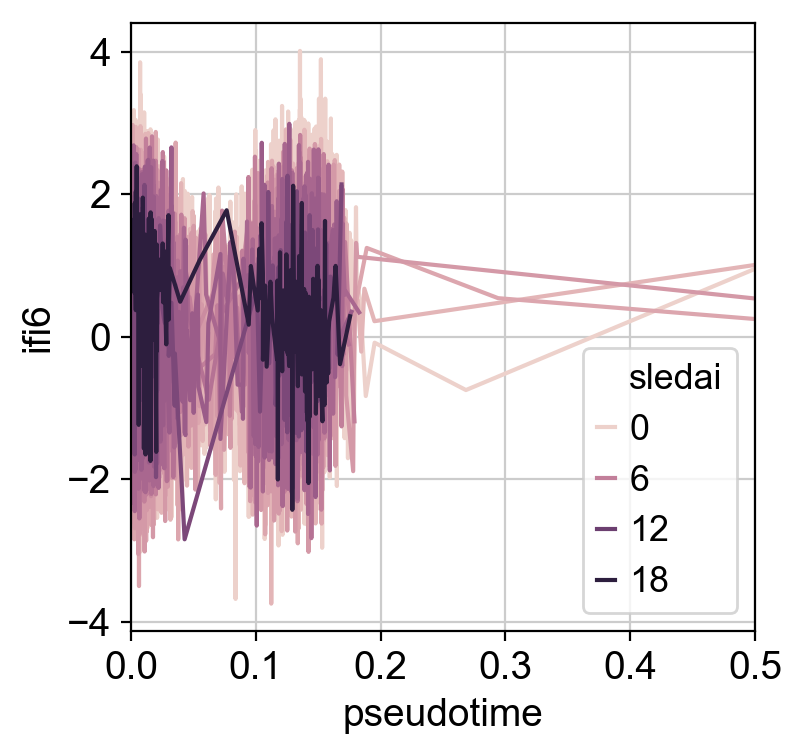

In [125]:
bdata_lineage = pd.DataFrame({"ifi6":np.asarray(adata_mono[:, "IFI6"].X).reshape(-1,), "pseudotime":adata_mono.obs["dpt_pseudotime"], "sledai":adata_mono.obs["SLEDAI"].astype("int64")})
out = sb.lineplot(x="pseudotime", y="ifi6", hue="sledai", data=bdata_lineage)
out.set(xlim=(0,0.5))